
---



> # *Categorical Face Mask detection with Convolutional NNs (CNN) using PyTorch*

```
>> Hello CNN
```


---

#### **Importing Libraries**

In [1]:
import random
import os
import time

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import glob
from PIL import Image
from datetime import datetime
from pytz import timezone

from google.colab import files
from google.colab import drive

import seaborn as sns
import torch
import torch.optim as optim

from torch.nn import Conv2d, BatchNorm2d, ReLU, Dropout2d, MaxPool2d, Sequential, Module, CrossEntropyLoss
from tqdm.notebook import tqdm
from torchvision import transforms, utils, datasets
from torch.utils.data import Dataset, DataLoader, SubsetRandomSampler
from torchvision.datasets import ImageFolder

from sklearn.metrics import classification_report, confusion_matrix, mean_squared_error, accuracy_score
from sklearn.model_selection import KFold

#### **Defining plot methods**

In [2]:
def plt_folds(kfolds, fold_vals, figsize, ysize, ylabel):
    folds = []
    for i in range(kfolds):
        folds.append('Fold ' + str(i + 1))
    sns.set_style("whitegrid")
    plt.figure(figsize=figsize)
    plt.yticks(ysize)
    plt.ylabel(ylabel)
    plt.xlabel(str(kfolds) + "-Fold Cross Validation")
    
    sns.barplot(x=folds, y=fold_vals)
    plt.show()

def plot_from_dict(dict_obj, plot_title, **kwargs):
    return sns.barplot(data=pd.DataFrame.from_dict([dict_obj]).melt()
    , x="variable", y="value", hue="variable", **kwargs).set_title(plot_title)

def plt_acc_loss(train, epochs, plttype):
    epochstoplot = range(1, epochs + 1)
    plt.plot(epochstoplot, train, label='Training ' + plttype)
    plt.title('Training ' + plttype)
    plt.xlabel('Epochs')
    plt.ylabel(plttype)
    plt.legend()
    plt.show()

def plt_torch_test_acc(tensor_dict):
    n = len(tensor_dict)
    vmax = max(v.abs().max() for v in tensor_dict.values())
    figsize = (2 * n, 6)
    fig, axes = plt.subplots(1, n, figsize=figsize, constrained_layout=True, squeeze=True)
    axes = axes.flat if isinstance(axes, np.ndarray) else (axes,)
    for (name, v), ax in zip(tensor_dict.items(), axes):
        v = torch.squeeze(v.detach())
        if v.ndim == 1:
            v = v.view(-1, 1)
        img = ax.matshow(v, vmin=-vmax, vmax=vmax, cmap=plt.get_cmap('bwr'))
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_title(name)
    fig.colorbar(img, cax=fig.add_axes([0.985, 0.25, 0.03, .5]))

####  **Mounting Google Drive and seed initialization**

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
# data directory with all data

root_dir = '/content/drive/MyDrive/Colab Notebooks/COMP6721/datasets/'
data_dir = '/content/drive/MyDrive/Colab Notebooks/COMP6721/datasets/fixed_bias'


gpu = torch.device("cuda" if torch.cuda.is_available() else "cpu")

random.seed(0)
np.random.seed(0)
torch.manual_seed(0)
torch.cuda.manual_seed(0)
% matplotlib inline
sns.set_style('darkgrid')
workers = 2 # for torch gpu

### **1. Data Pre-processing**

In [4]:
image_transforms = transforms.Compose(
    [transforms.Resize((300, 300)),
     transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

In [5]:
dataset = ImageFolder(root=data_dir, transform=image_transforms)

idx2class = {v: k for k, v in dataset.class_to_idx.items()}

print('Dataset has', len(dataset), 'elements with the following classes:\n', dataset.class_to_idx)

Dataset has 2375 elements with the following classes:
 {'cloth': 0, 'n95': 1, 'n95v': 2, 'nfm': 3, 'srg': 4}


In [6]:
count_dict = {k: 0 for k, v in dataset.class_to_idx.items()}
    
for element in dataset:
    y_lbl = element[1]
    y_lbl = idx2class[y_lbl]
    count_dict[y_lbl] += 1

print("Distribution of classes: \n", count_dict)

Distribution of classes: 
 {'cloth': 509, 'n95': 424, 'n95v': 438, 'nfm': 567, 'srg': 437}


In [7]:
y_label_plt = []
count_of_y_label = []
for key, values in count_dict.items():
  y_label_plt.append(key)
  count_of_y_label.append(values)

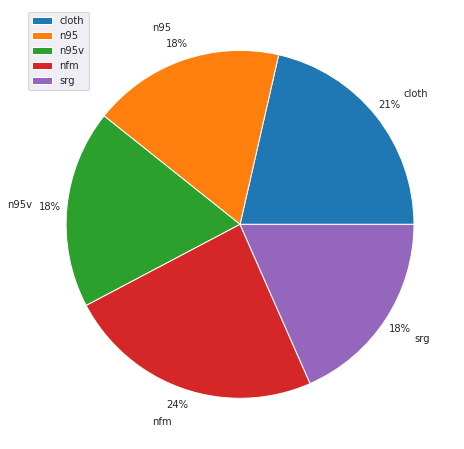

In [8]:
plt.pie(count_of_y_label, labels=y_label_plt, autopct='%1.0f%%', pctdistance=1.1, labeldistance=1.2)
plt.gcf().set_size_inches(8, 8)
plt.legend()
plt.show()

### **2. Defining Dataset Split**

In [9]:
dataset_size = len(dataset)
dataset_indices = list(range(dataset_size))
np.random.shuffle(dataset_indices)

test_split_index = int(np.floor(0.2 * dataset_size))
train_idx, test_idx = dataset_indices[test_split_index:], dataset_indices[:test_split_index]

train_sampler = SubsetRandomSampler(train_idx)
test_sampler = SubsetRandomSampler(test_idx)

In [10]:
print(len(train_sampler))
print(len(test_sampler))

1900
475


In [11]:
batch_size = 16

train_loader = DataLoader(dataset=dataset, batch_size=batch_size, sampler=train_sampler, num_workers=workers)
test_loader = DataLoader(dataset=dataset, batch_size=1, sampler=test_sampler, num_workers=workers)

In [12]:
def get_class_distribution_loaders(dataloader_obj, dataset_obj):
    count_dict = {k: 0 for k, v in dataset_obj.class_to_idx.items()}
    if dataloader_obj.batch_size == 1:
        for _, label_id in dataloader_obj:
            y_idx = label_id.item()
            y_lbl = idx2class[y_idx]
            count_dict[str(y_lbl)] += 1
    else:
        for _, label_id in dataloader_obj:
            for idx in label_id:
                y_idx = idx.item()
                y_lbl = idx2class[y_idx]
                count_dict[str(y_lbl)] += 1
    return count_dict

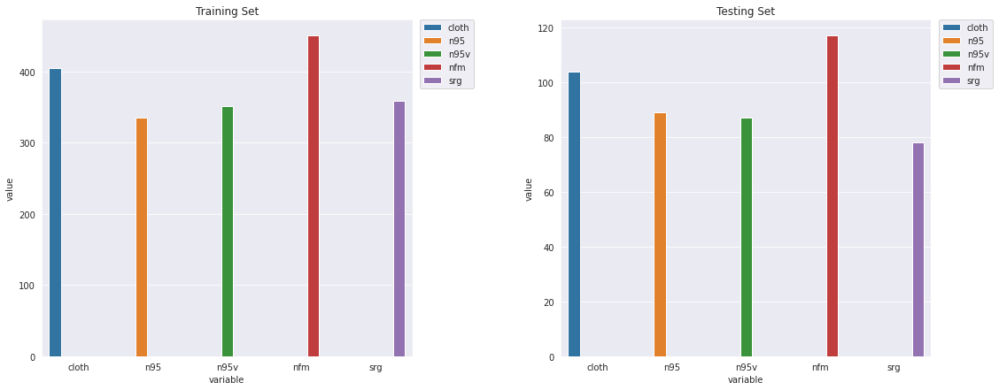

In [13]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(18, 7))
plt.subplots_adjust(wspace=0.4)

plot_from_dict(get_class_distribution_loaders(train_loader, dataset), plot_title="Training Set", ax=axes[0])
plot_from_dict(get_class_distribution_loaders(test_loader, dataset), plot_title="Testing Set", ax=axes[1])

for i in fig.get_axes():
  i.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

In [14]:
single_batch = next(iter(train_loader))
single_image = single_batch[0][0]
print('Single batch: ', single_batch[0].shape)
print('single image shape: ', single_image.shape)

Single batch:  torch.Size([16, 3, 300, 300])
single image shape:  torch.Size([3, 300, 300])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Output label tensors:  tensor([0, 4, 0, 3, 1, 2, 0, 3, 4, 2, 1, 0, 1, 0, 3, 2])

Output label tensor shape:  torch.Size([16])


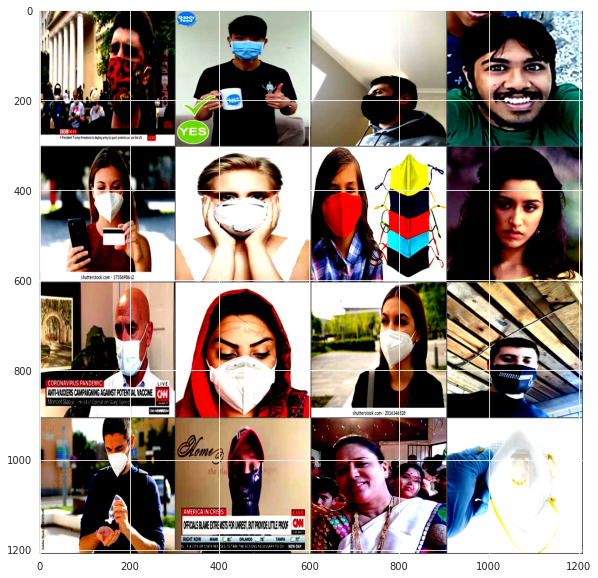

In [15]:
single_batch_grid = utils.make_grid(single_batch[0], nrow=4)
plt.figure(figsize=(10, 10))
plt.imshow(single_batch_grid.permute(1, 2, 0) + 0.3)
print("Output label tensors: ", single_batch[1])
print("\nOutput label tensor shape: ", single_batch[1].shape)



---


### **3. Convolutional Neural Networks (CNN)**

We build Convolutional Neural Networks with three blocks.


*   First Conv2D is implemented
*   Then Batch Normal with Rectifier function
*   Dropout is considered 0.1

*In order to create the fully connected part, Maxpooling with filter size 2 is implemented, after applying Two Dimentional Conversation*

In order to find the output of the fully connected part, we apply the following equation.

\begin{align}
        output = \frac{InputSize - KernelSize + 2.padding}{stride factor} + 1
    \end{align}


---



    torch.nn.Conv2d(in_channels, out_channels, kernel_size, stride=1, padding=0, dilation=1, groups=1, bias=True, padding_mode='zeros', device=None, dtype=None)

***padding is 0 by default***



#### **3.1. Model Hyper-Parameters**

In [16]:
learning_rate = 0.00146
epochs = 20
wd = 1e-6
dropout = 0.1

#### **3.2. Building the Model**

In [17]:
class CNN_Classifier(Module):
    def __init__(self):
        super(CNN_Classifier, self).__init__()
        self.block1 = self.conv_block(input=3, output=512, dropout=dropout, kernel_size=5, stride_factor=2)
        self.block2 = self.conv_block(input=512, output=256, dropout=dropout, kernel_size=3, stride_factor=2)
        self.block3 = self.conv_block(input=256, output=128, dropout=dropout, kernel_size=3, stride_factor=2)
        self.block4 = self.conv_block(input=128, output=64, dropout=dropout, kernel_size=3, stride_factor=2)

        # Fully Connected Network
        self.lastcnn = Conv2d(in_channels=64, out_channels=5, kernel_size=4, stride=2)
        self.maxpool = MaxPool2d(kernel_size=2, stride=2)

    def forward(self, x):
        x = self.block1(x)
        x = self.maxpool(x)
        x = self.block2(x)
        x = self.block3(x)
        x = self.block4(x)
        x = self.maxpool(x)
        x = self.lastcnn(x)
        return x

    def conv_block(self, input, output, dropout, kernel_size, stride_factor):
        cnn_model_block = Sequential(
            Conv2d(in_channels=input, out_channels=output, kernel_size=kernel_size, stride=stride_factor),
            BatchNorm2d(num_features=output),
            ReLU(),
            Dropout2d(p=dropout)
        )
        return cnn_model_block

In [18]:
# Model Summary
print(CNN_Classifier())

CNN_Classifier(
  (block1): Sequential(
    (0): Conv2d(3, 512, kernel_size=(5, 5), stride=(2, 2))
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Dropout2d(p=0.1, inplace=False)
  )
  (block2): Sequential(
    (0): Conv2d(512, 256, kernel_size=(3, 3), stride=(2, 2))
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Dropout2d(p=0.1, inplace=False)
  )
  (block3): Sequential(
    (0): Conv2d(256, 128, kernel_size=(3, 3), stride=(2, 2))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Dropout2d(p=0.1, inplace=False)
  )
  (block4): Sequential(
    (0): Conv2d(128, 64, kernel_size=(3, 3), stride=(2, 2))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Dropout2d(p=0.1, inplace=False)
  )
  (lastcnn): Conv2d(64, 5, kernel_size=(4, 4

#### **3.3. Training the Model**

In [19]:
def measure_acc(y_predict, y_test):
    y_pred_softmax = torch.log_softmax(y_predict, dim=1)
    _, y_pred = torch.max(y_pred_softmax, dim=1)
    correct_pred = (y_pred == y_test).float()
    accuracy = correct_pred.sum() / len(correct_pred)
    accuracy = torch.round(accuracy * 100)
    return accuracy

In [20]:
start_time = time.time()
accuracy_stats = {'train': []}
loss_stats = {'train': []}

pre_trained_model = False

cnn_model = CNN_Classifier()

try:
  cnn_model.load_state_dict(torch.load('/content/drive/MyDrive/Colab Notebooks/COMP6721/phase2_model_weights.pth'))
  cnn_model.eval()
  pre_trained_model = True
  print('Using pretrained model..')

except:
  cnn_model.to(gpu)
  loss = CrossEntropyLoss()
  optimizer = optim.Adam(cnn_model.parameters(), lr=learning_rate, weight_decay=wd)
  print('Training model training')
  for epoch in tqdm(range(1, epochs + 1)):

      # TRAINING
      train_epoch_loss = 0
      train_epoch_acc = 0
      cnn_model.train()

      for X_train, y_train in train_loader:
          X_train, y_train = X_train.to(gpu), y_train.to(gpu)

          optimizer.zero_grad()
          y_train_pred = cnn_model(X_train).squeeze()

          train_loss = loss(y_train_pred, y_train)
          train_acc = measure_acc(y_train_pred, y_train)

          train_loss.backward()
          optimizer.step()

          train_epoch_loss += train_loss.item()
          train_epoch_acc += train_acc.item()

      loss_stats['train'].append(train_epoch_loss / len(train_loader))
      accuracy_stats['train'].append(train_epoch_acc / len(train_loader))
      
      print(
          f'Epochs {epoch + 0:02}: | Train Loss: {train_epoch_loss / len(train_loader):.4f} '
          f'| Train Accuracy: {train_epoch_acc / len(train_loader):.2f}')
        
if not pre_trained_model:
  torch.save(cnn_model.state_dict(), '/content/drive/MyDrive/Colab Notebooks/COMP6721/phase2_model_weights.pth')
print(f'Total Training Time: {(time.time() - start_time)/60:.2f} min\n')

Training model training


  0%|          | 0/20 [00:00<?, ?it/s]

Epochs 01: | Train Loss: 1.2739 | Train Accuracy: 48.85
Epochs 02: | Train Loss: 1.0333 | Train Accuracy: 60.34
Epochs 03: | Train Loss: 0.9085 | Train Accuracy: 66.03
Epochs 04: | Train Loss: 0.8378 | Train Accuracy: 69.46
Epochs 05: | Train Loss: 0.7555 | Train Accuracy: 71.55
Epochs 06: | Train Loss: 0.6843 | Train Accuracy: 75.28
Epochs 07: | Train Loss: 0.6075 | Train Accuracy: 77.76
Epochs 08: | Train Loss: 0.5550 | Train Accuracy: 79.90
Epochs 09: | Train Loss: 0.4885 | Train Accuracy: 81.46
Epochs 10: | Train Loss: 0.4230 | Train Accuracy: 84.90
Epochs 11: | Train Loss: 0.3559 | Train Accuracy: 87.87
Epochs 12: | Train Loss: 0.3045 | Train Accuracy: 89.39
Epochs 13: | Train Loss: 0.2213 | Train Accuracy: 93.61
Epochs 14: | Train Loss: 0.2187 | Train Accuracy: 92.58
Epochs 15: | Train Loss: 0.1871 | Train Accuracy: 94.14
Epochs 16: | Train Loss: 0.1219 | Train Accuracy: 96.86
Epochs 17: | Train Loss: 0.1075 | Train Accuracy: 97.42
Epochs 18: | Train Loss: 0.1254 | Train Accuracy

#### **3.4. Ploting the accuracy and loss**

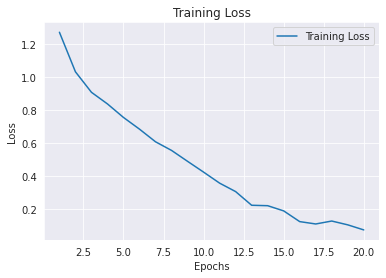

In [21]:
if pre_trained_model == False:
   plt_acc_loss(loss_stats['train'], epochs, 'Loss')
else:
   print('Pretrained model is used.')

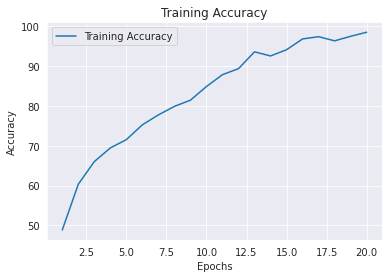

In [22]:
if pre_trained_model == False:
   plt_acc_loss(accuracy_stats['train'], epochs, 'Accuracy')
else:
   print('Pretrained model is used.')

### **4. Testing the CNN model**

In [23]:
image_transforms_tst = transforms.Compose(
    [transforms.Resize((300, 300)),
     transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

# For demo
demo = False
if demo:     
  tst_dir = 'drive/MyDrive/demo'
  test_set = datasets.ImageFolder(root=tst_dir,transform=image_transforms_tst)
  test_loader = DataLoader(dataset=test_set, shuffle=True, batch_size=1, num_workers=workers)

```
Dataset has the following classes:
*   cloth: 0
*   n95: 1
*   n95v: 2
*   nfm: 3
*   srg: 4

```

  0%|          | 0/475 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


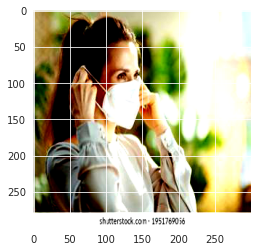

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


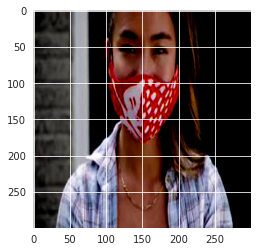

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


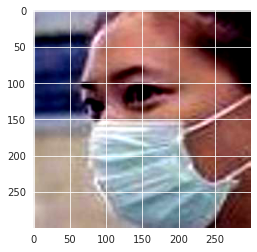

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


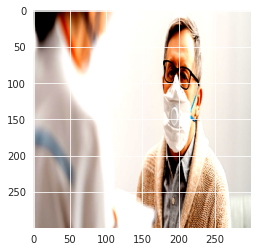

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


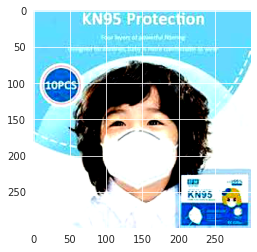

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


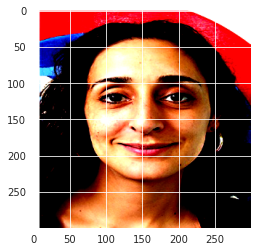

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


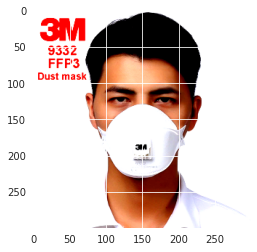

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


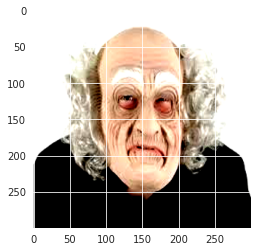

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


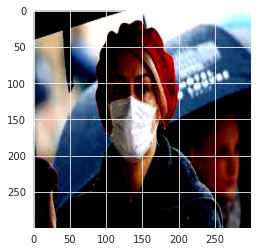

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


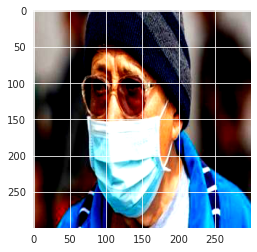

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


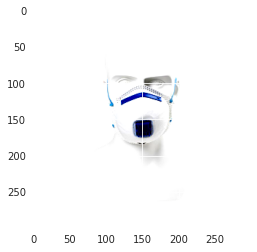

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


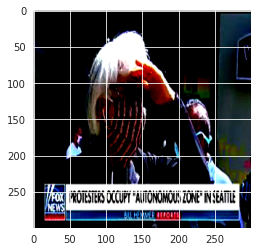

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


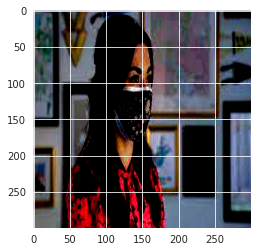

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


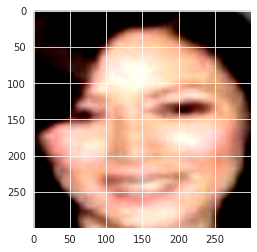

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


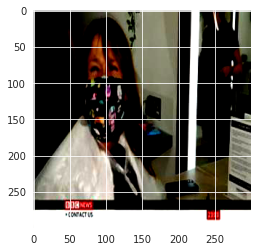

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


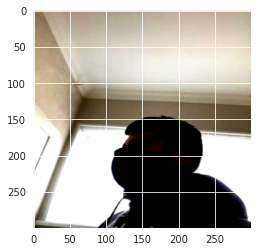

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


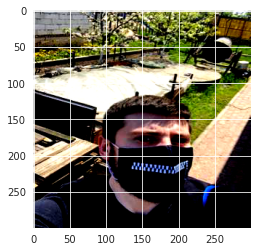

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


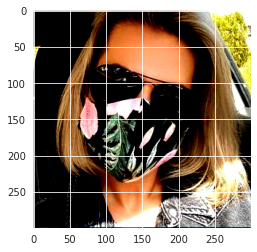

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


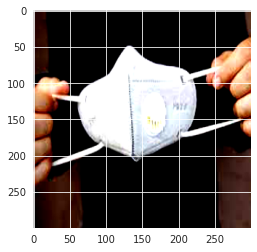

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


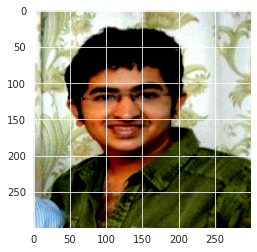

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


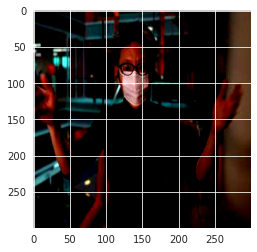

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


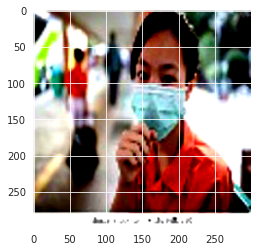

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


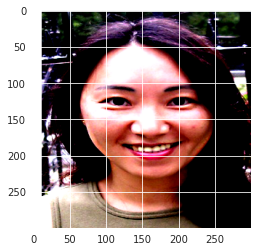

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


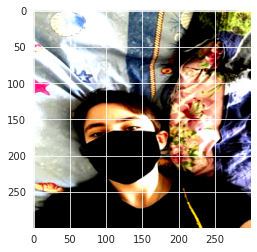

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


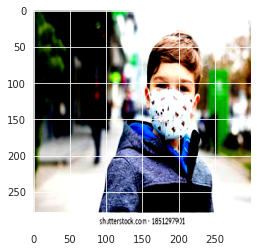

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


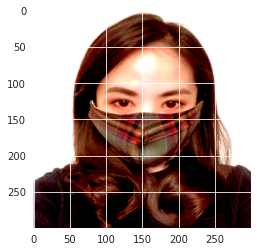

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


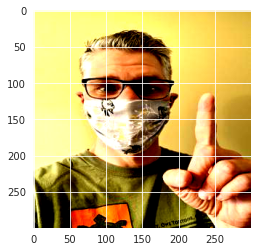

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


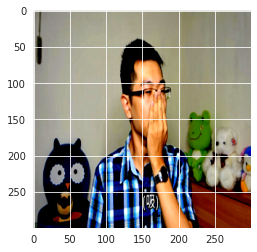

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


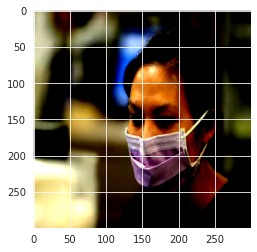

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


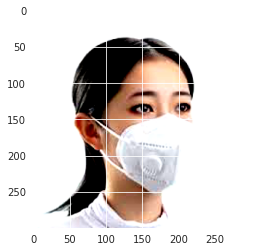

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


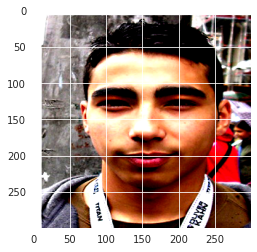

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


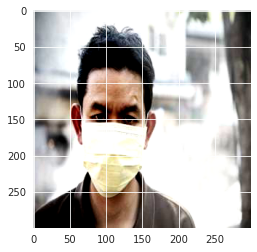

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


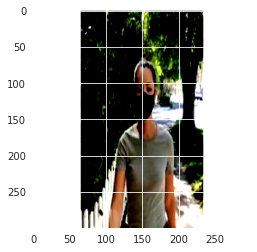

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


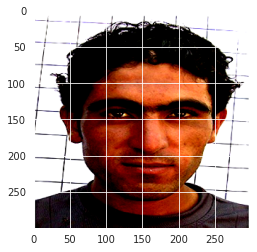

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


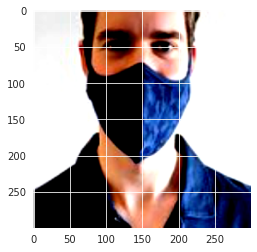

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


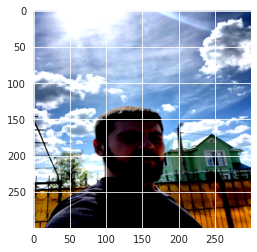

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


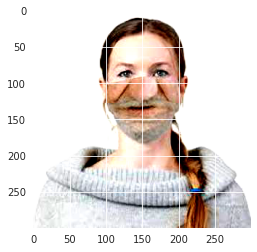

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


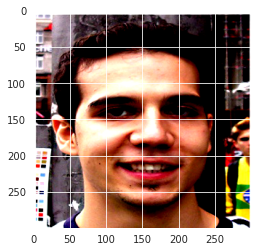

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


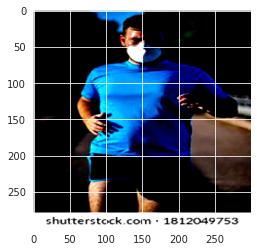

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


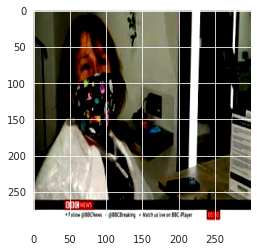

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


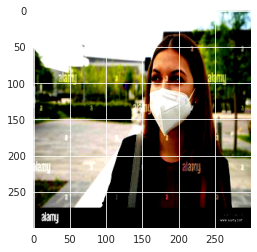

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


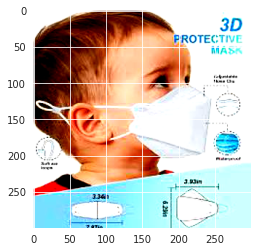

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


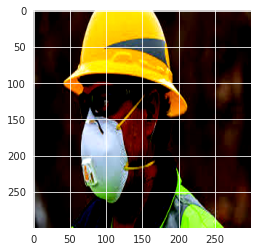

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


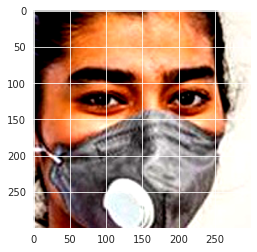

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


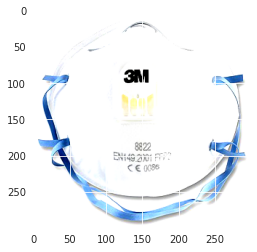

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


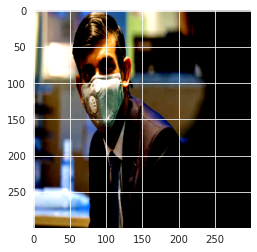

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


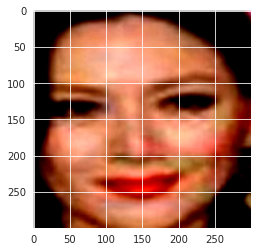

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


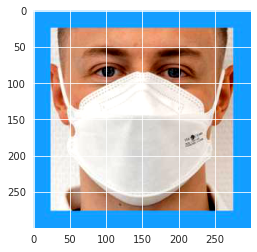

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


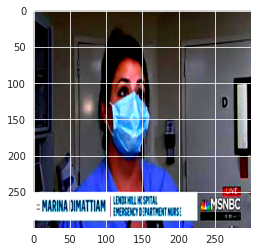

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


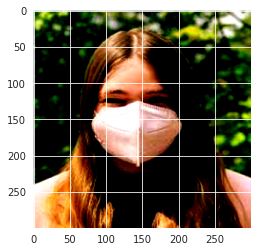

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


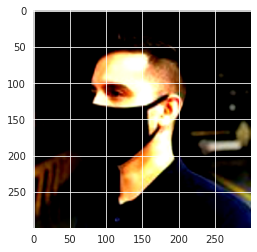

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


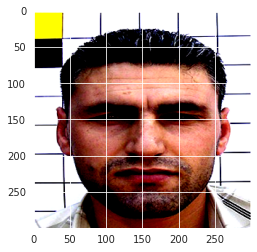

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


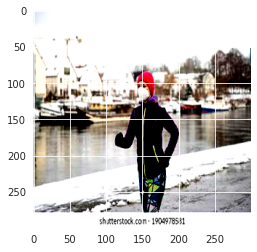

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


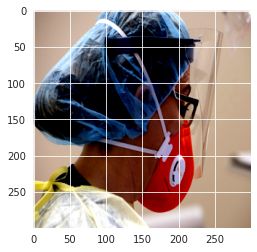

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


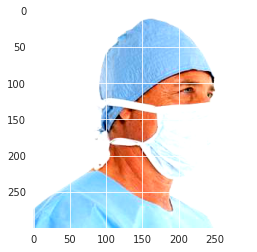

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


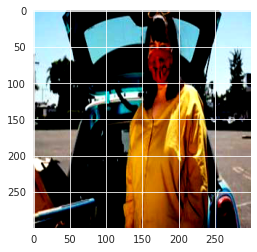

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


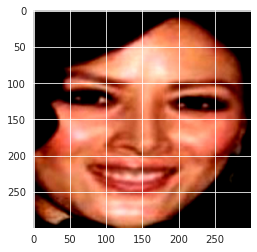

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


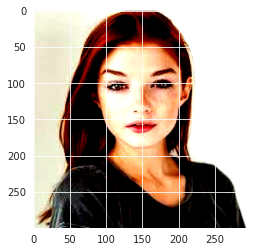

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


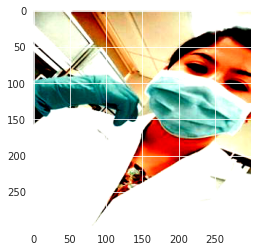

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


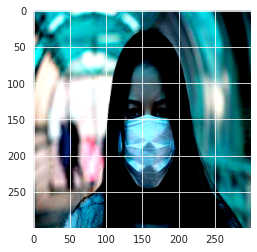

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


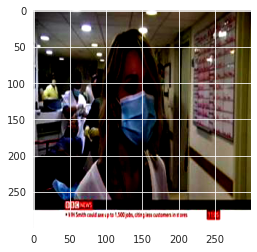

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


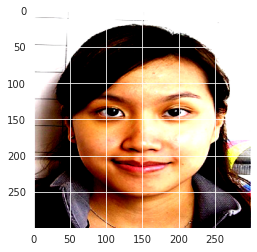

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


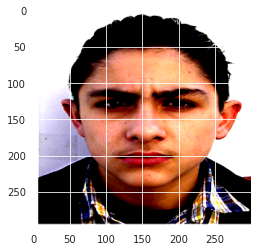

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


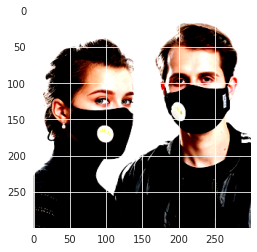

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


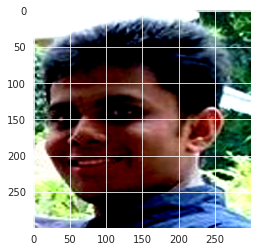

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


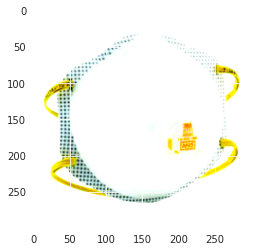

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


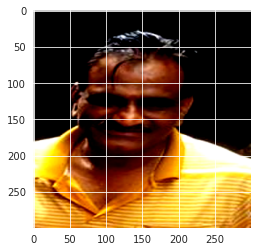

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


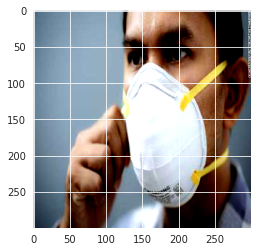

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


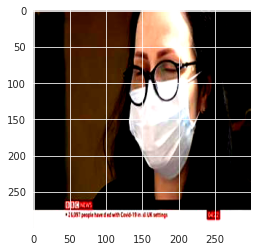

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


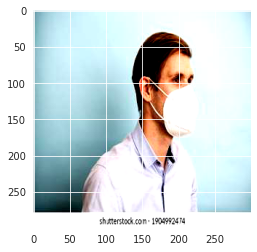

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


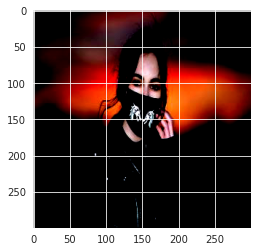

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


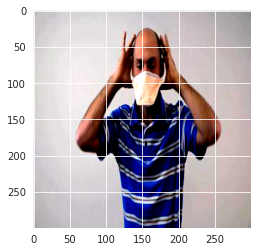

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


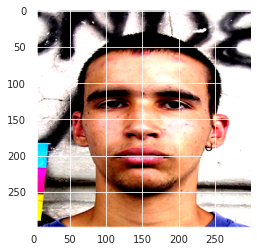

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


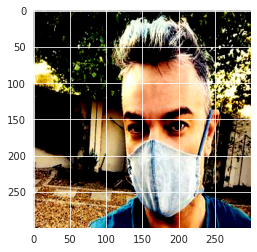

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


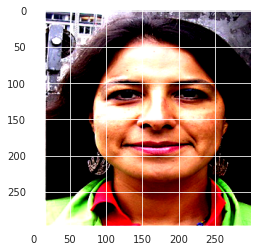

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


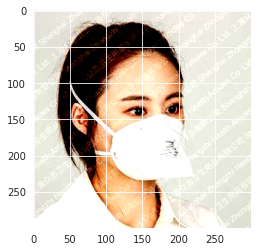

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


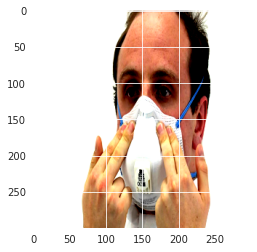

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


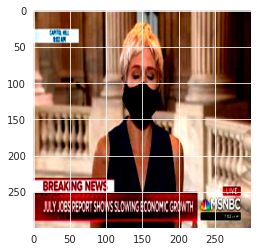

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


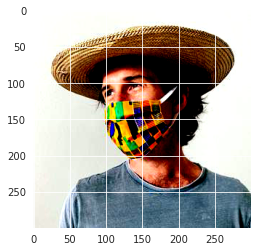

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


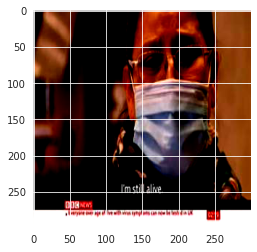

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


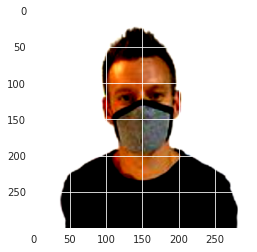

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


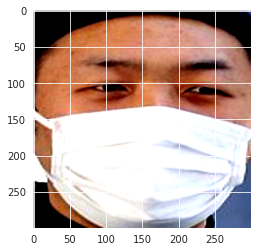

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


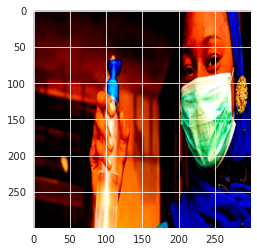

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


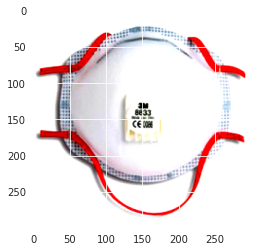

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


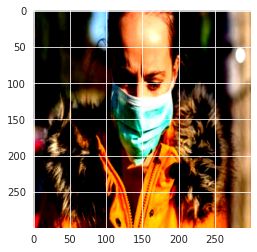

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


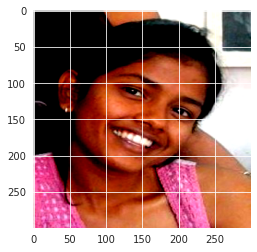

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


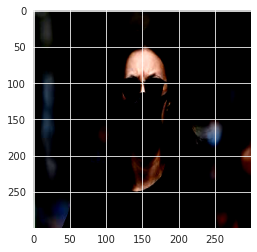

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


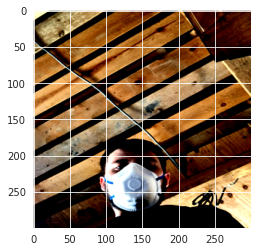

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


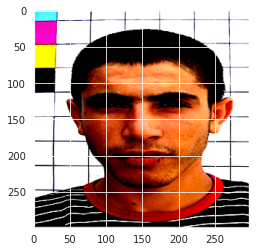

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


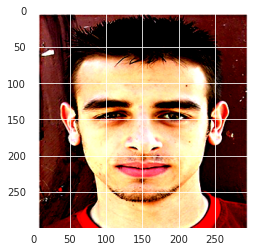

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


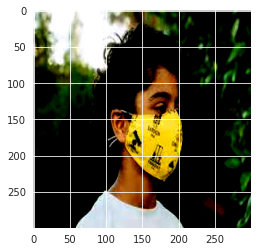

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


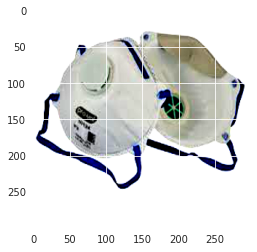

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


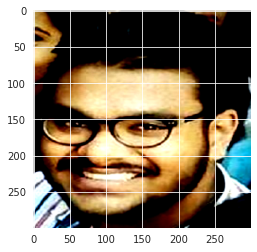

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


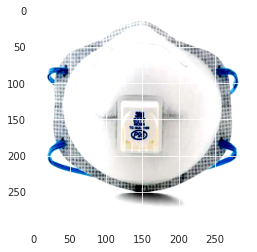

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


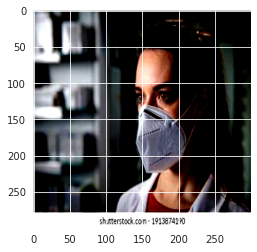

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


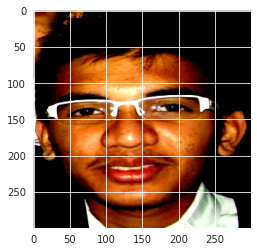

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


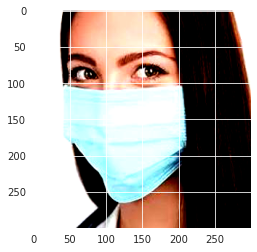

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


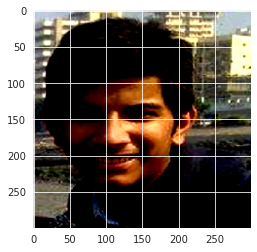

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


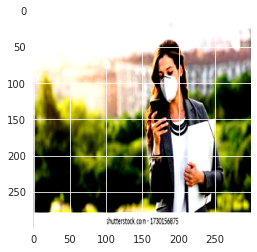

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


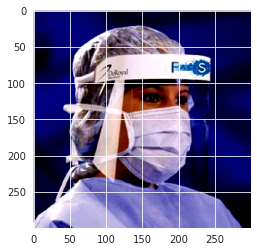

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


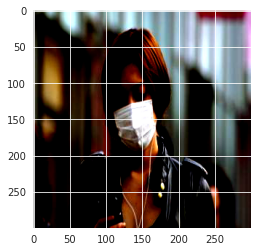

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


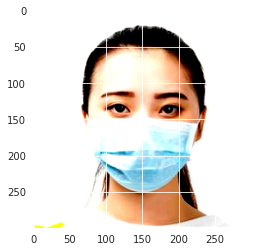

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


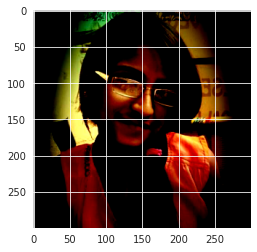

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


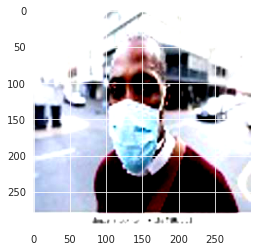

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


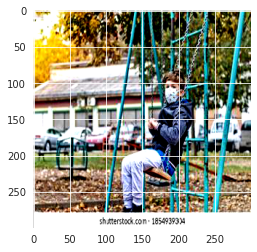

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


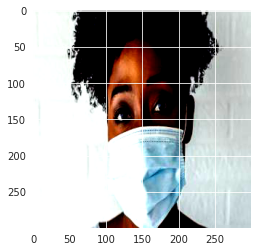

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


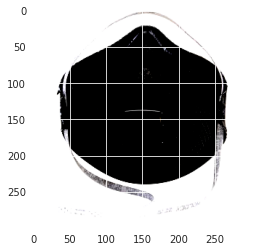

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


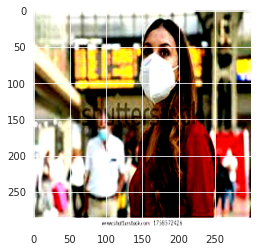

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


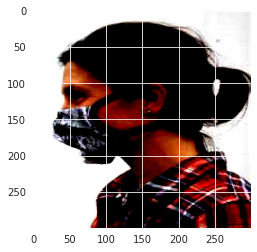

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


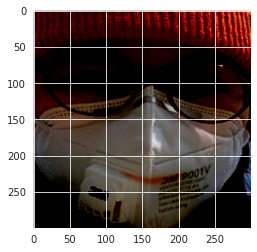

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


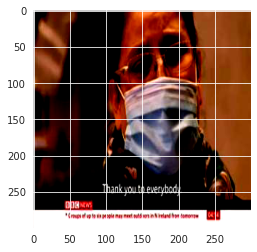

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


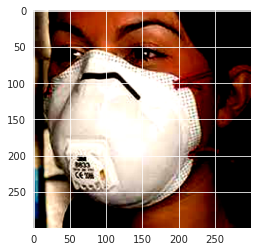

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


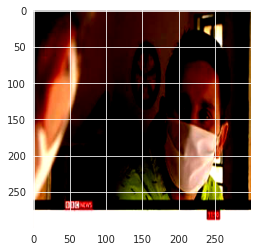

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


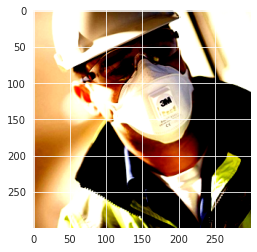

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


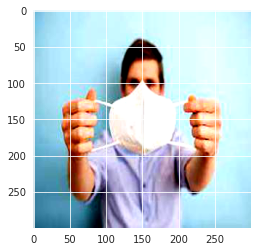

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


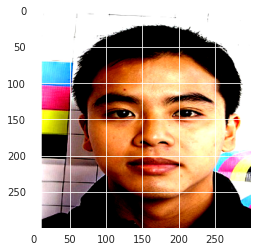

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


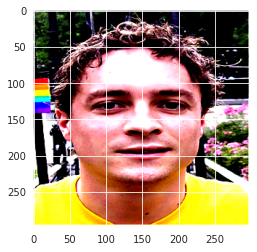

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


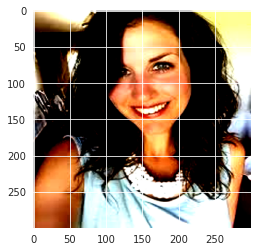

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


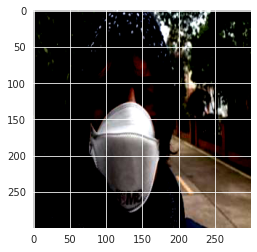

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


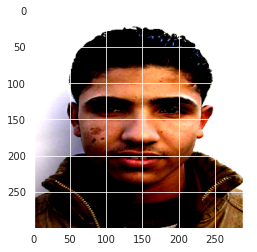

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


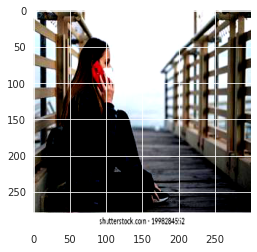

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


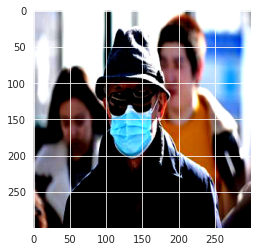

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


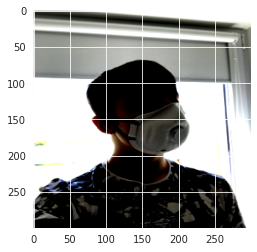

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


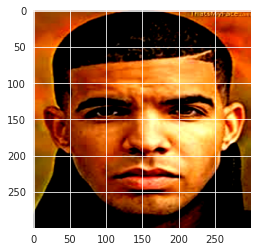

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


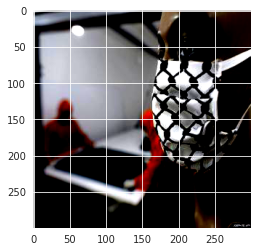

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


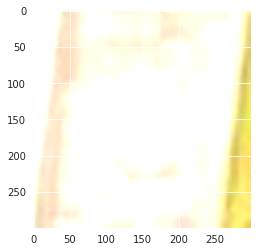

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


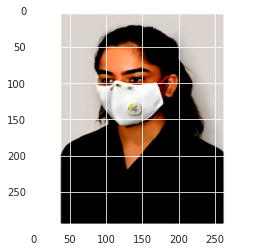

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


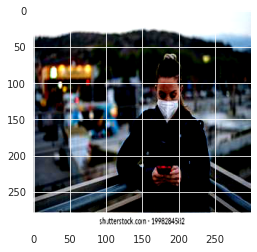

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


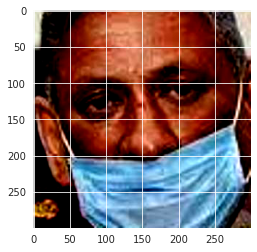

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


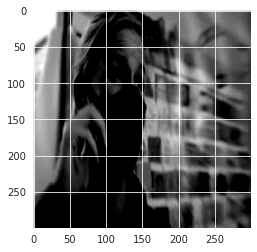

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


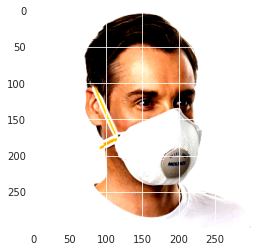

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


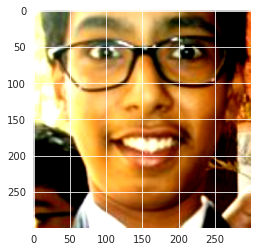

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


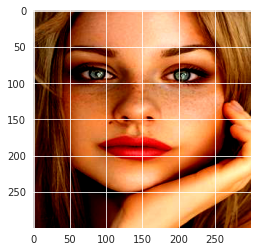

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


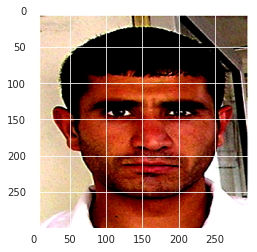

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


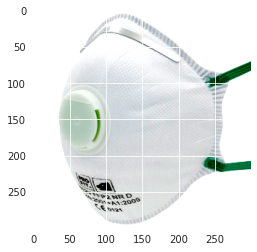

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


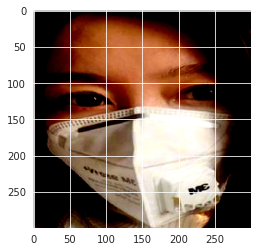

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


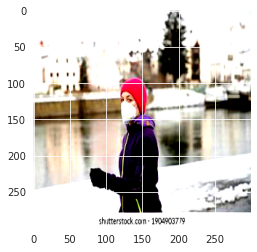

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


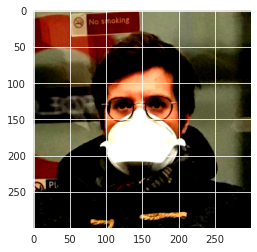

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


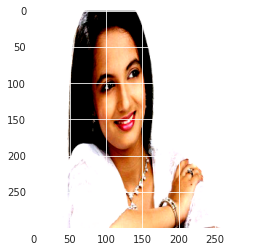

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


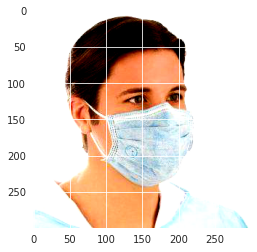

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


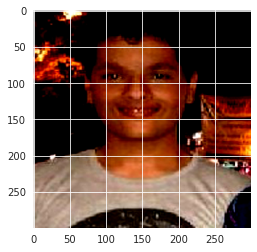

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


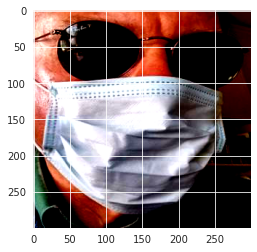

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


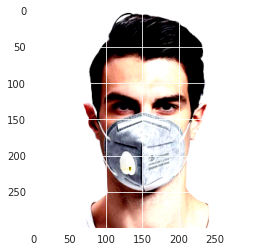

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


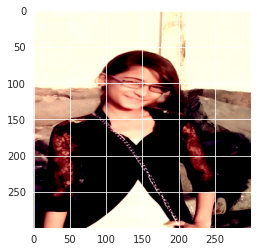

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


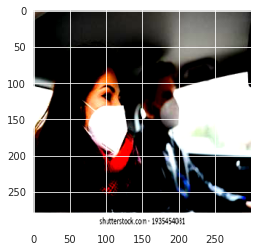

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


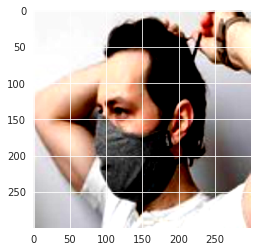

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


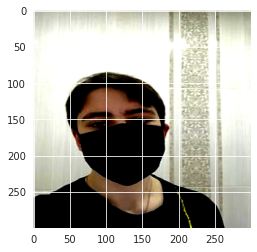

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


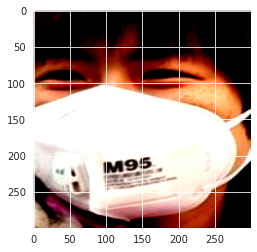

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


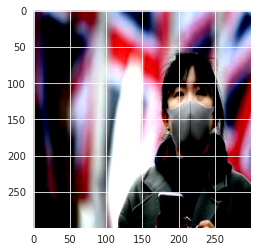

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


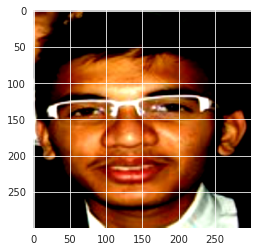

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


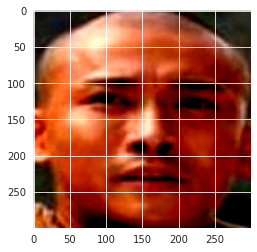

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


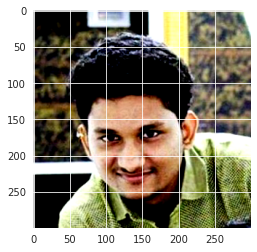

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


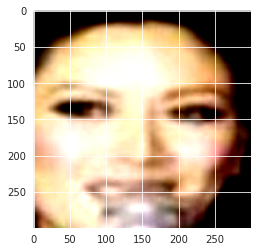

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


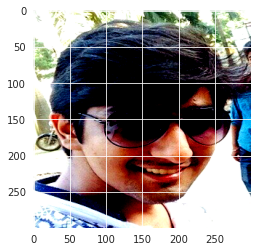

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


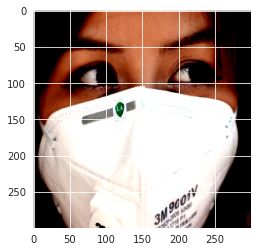

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


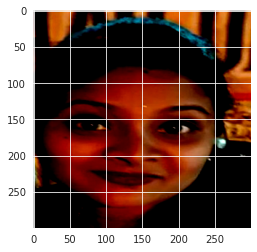

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


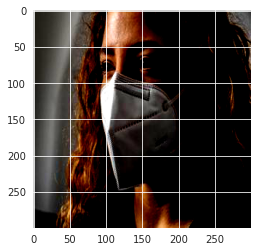

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


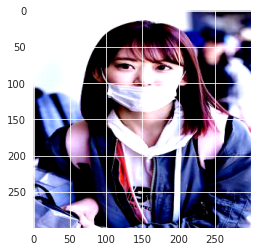

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


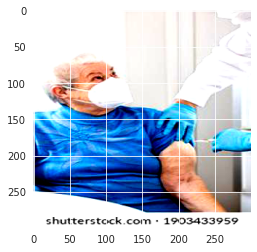

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


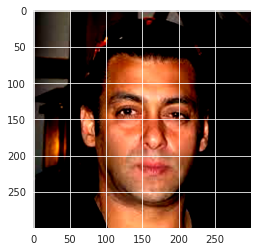

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


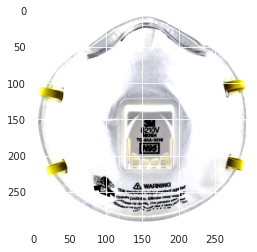

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


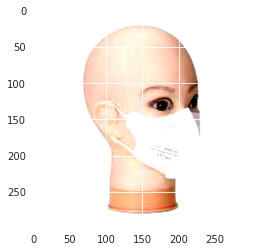

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


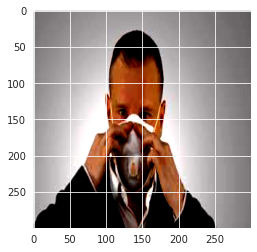

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


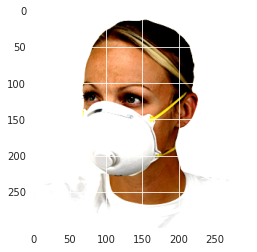

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


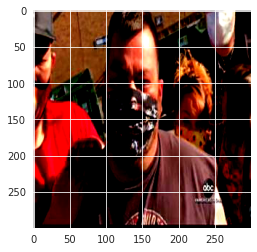

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


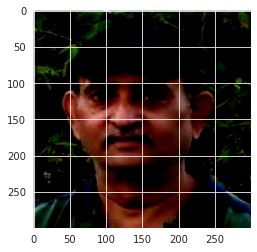

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


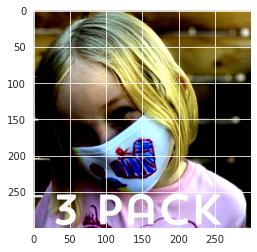

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


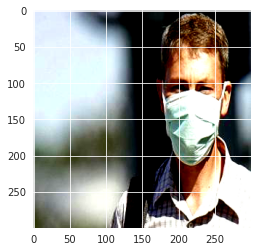

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


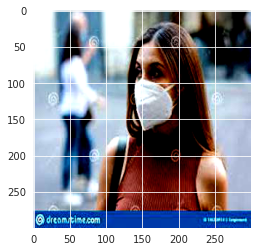

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


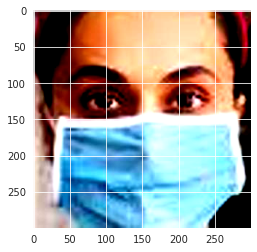

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


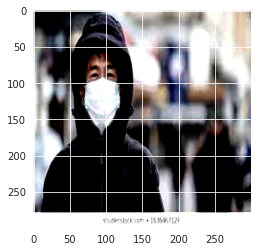

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


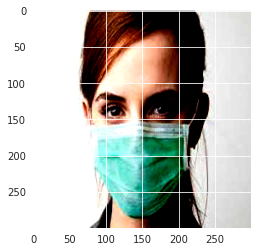

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


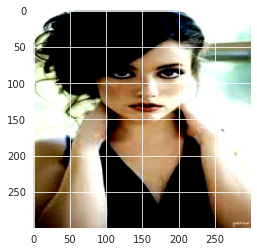

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


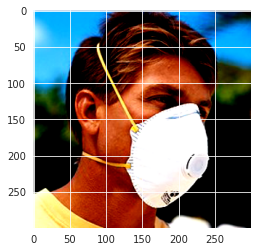

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


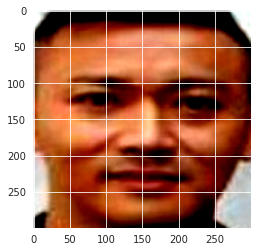

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


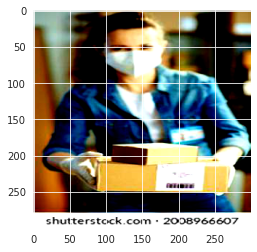

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


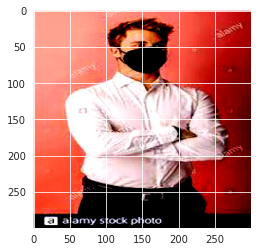

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


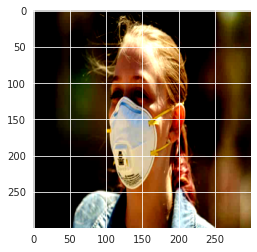

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


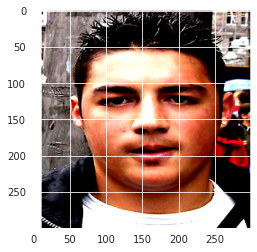

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


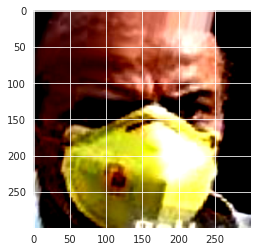

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


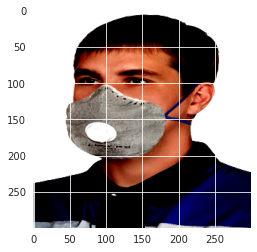

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


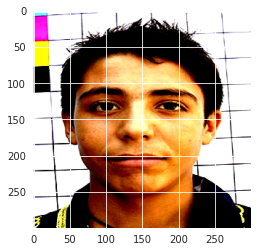

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


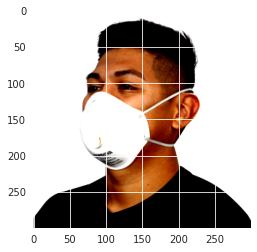

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


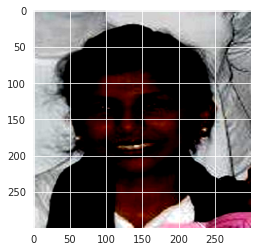

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


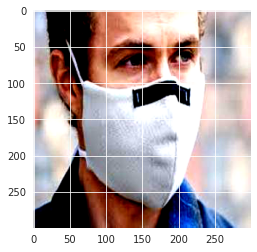

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


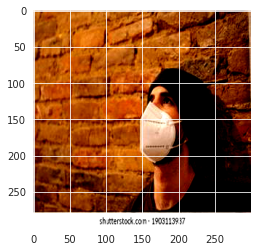

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


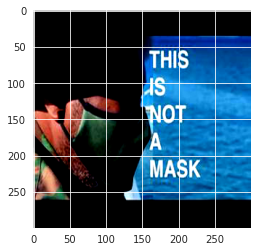

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


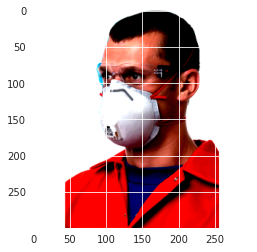

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


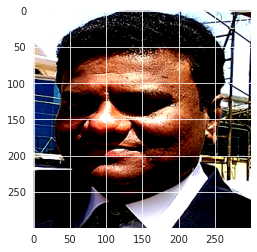

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


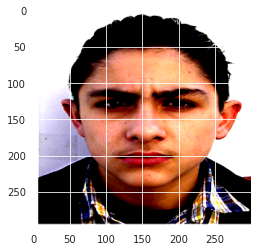

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


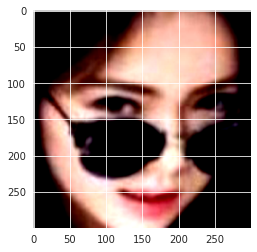

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


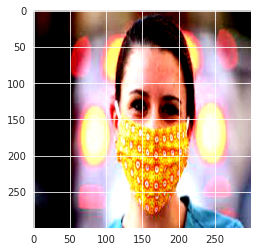

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


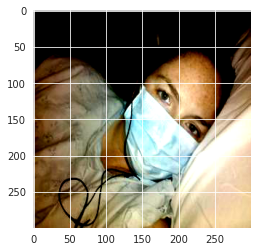

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


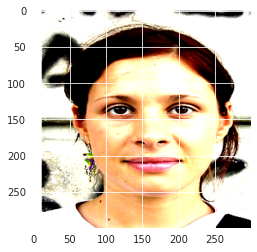

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


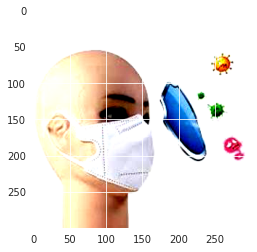

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


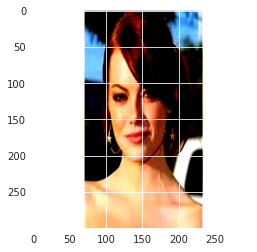

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


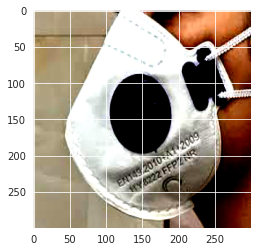

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


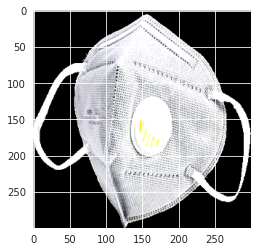

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


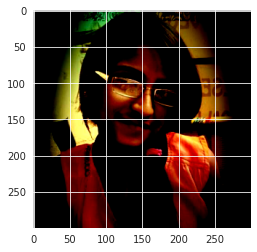

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


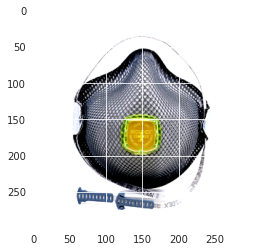

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


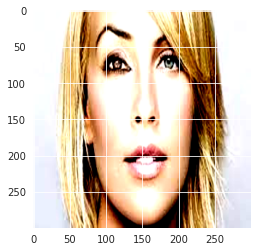

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


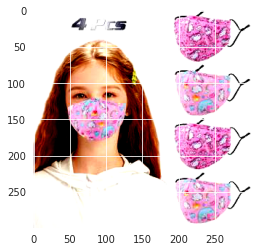

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


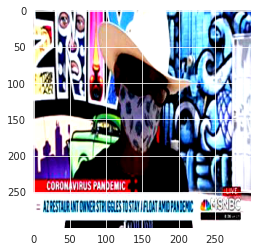

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


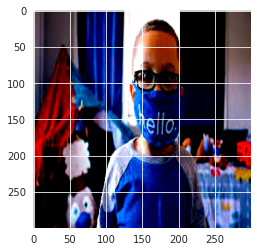

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


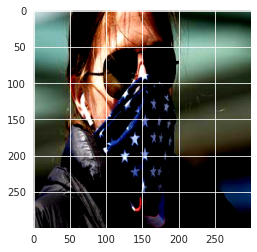

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


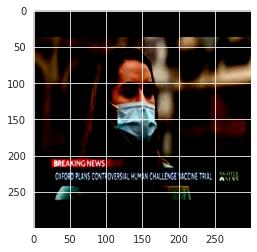

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


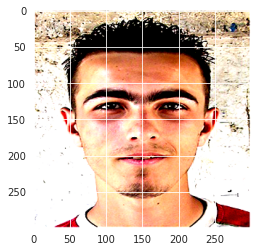

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


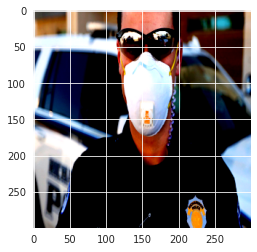

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


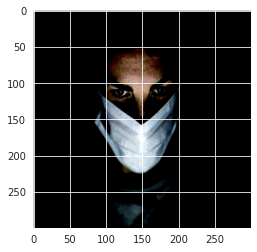

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


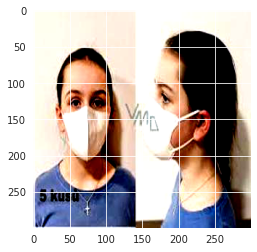

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


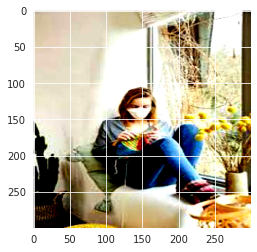

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


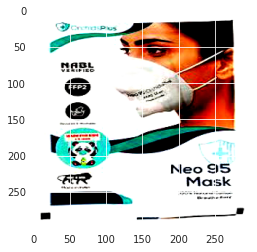

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


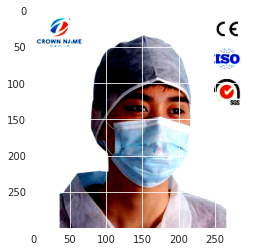

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


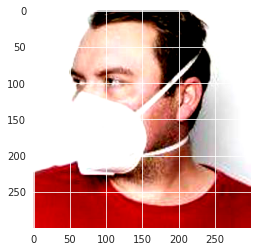

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


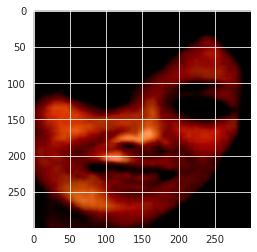

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


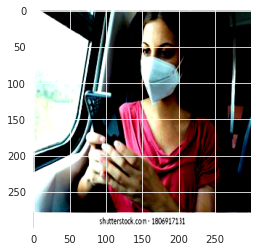

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


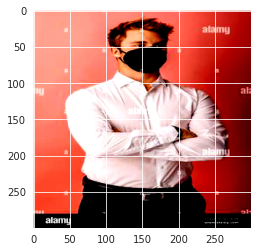

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


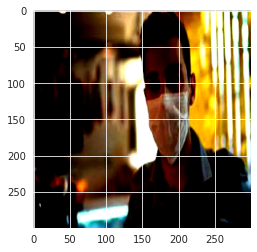

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


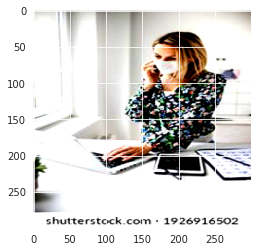

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


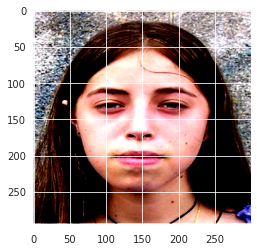

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


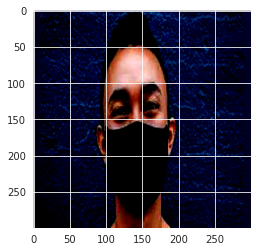

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


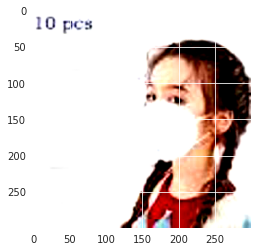

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


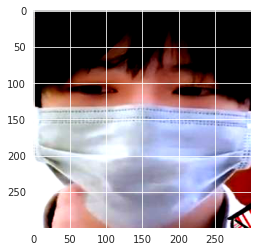

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


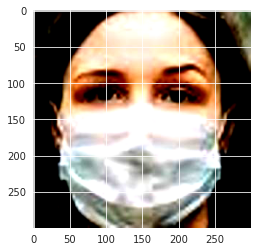

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


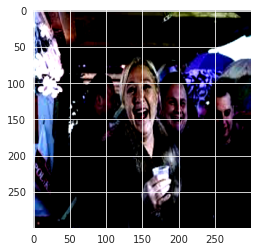

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


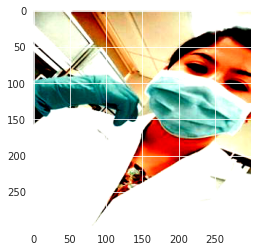

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


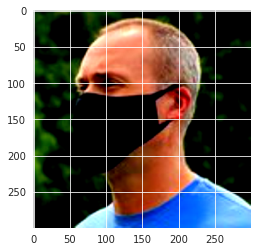

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


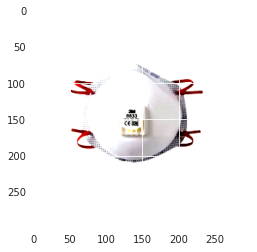

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


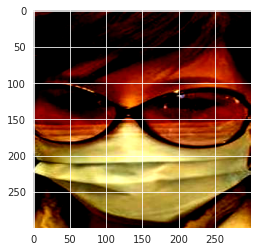

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


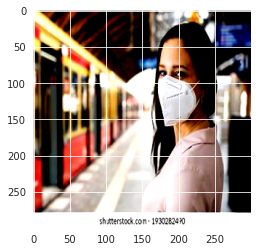

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


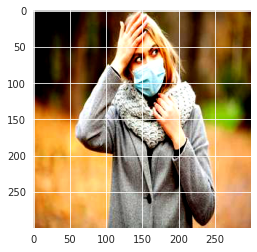

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


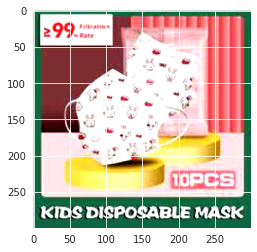

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


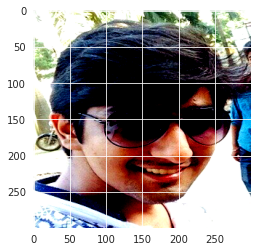

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


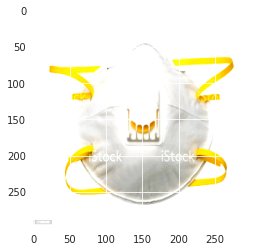

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


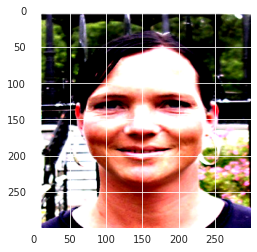

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


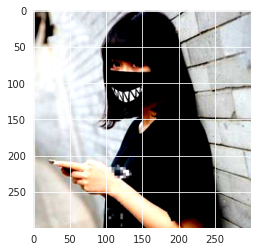

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


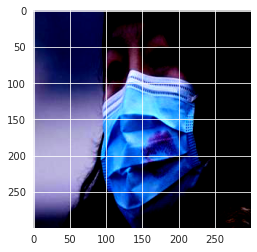

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


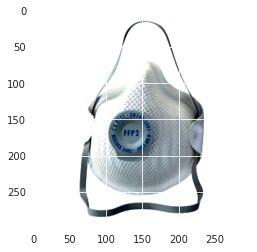

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


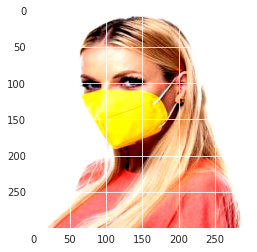

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


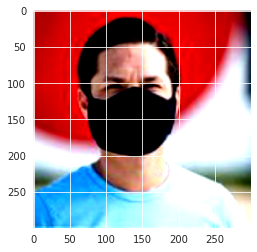

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


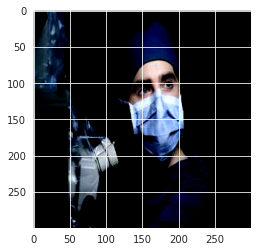

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


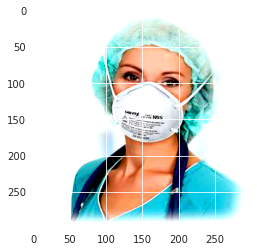

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


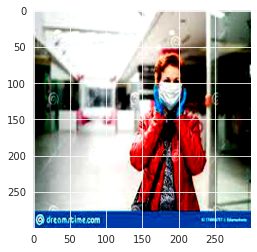

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


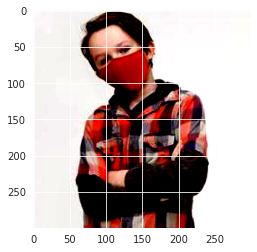

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


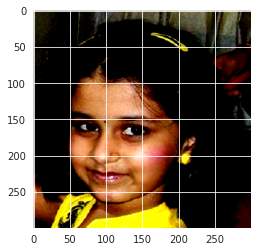

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


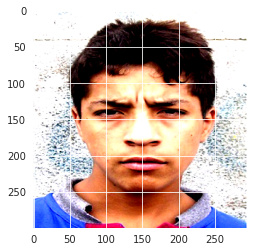

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


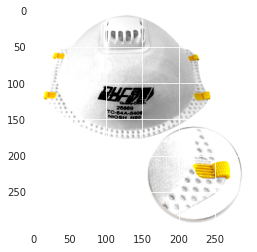

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


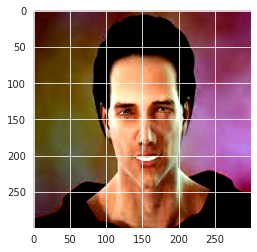

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


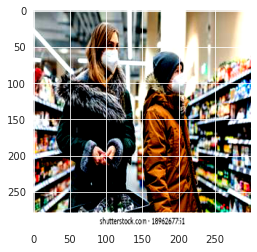

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


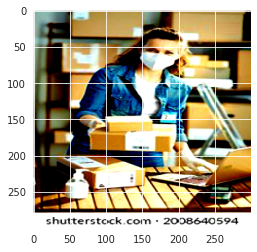

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


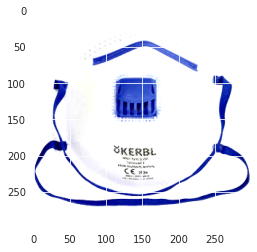

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


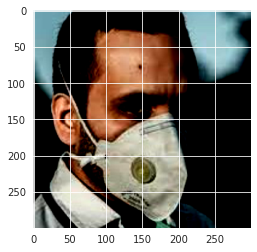

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


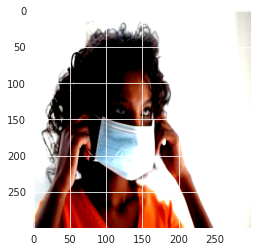

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


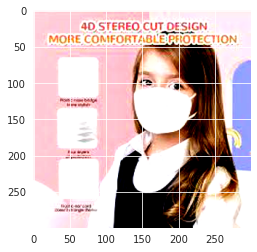

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


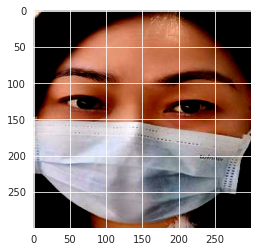

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


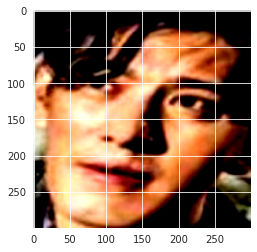

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


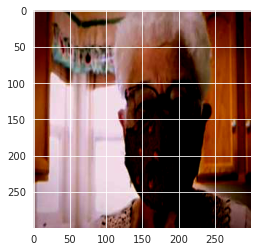

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


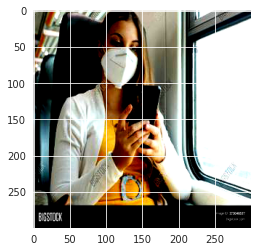

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


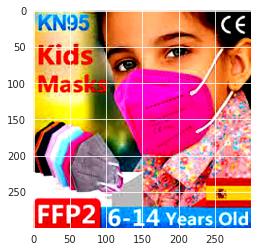

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


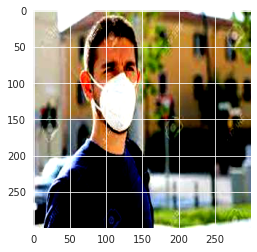

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


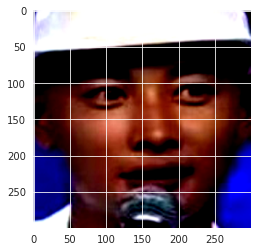

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


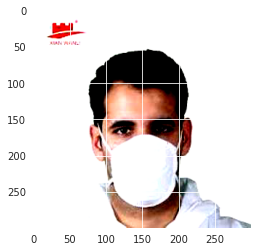

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


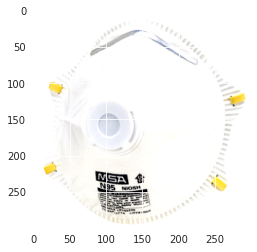

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


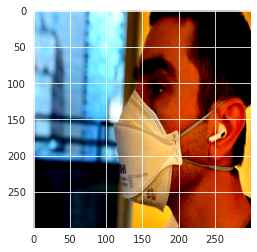

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


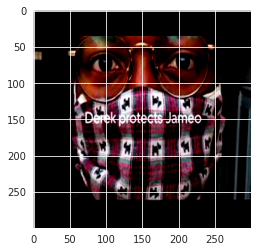

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


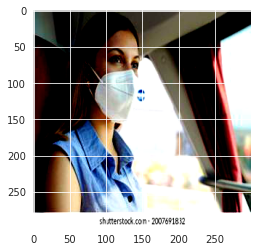

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


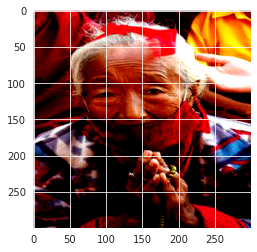

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


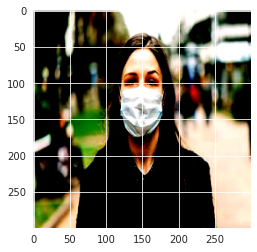

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


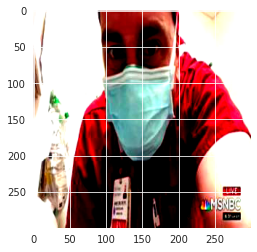

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


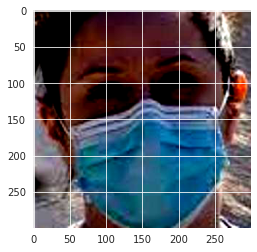

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


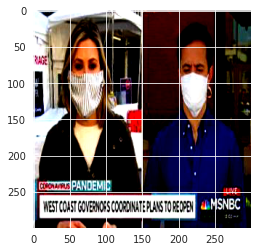

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


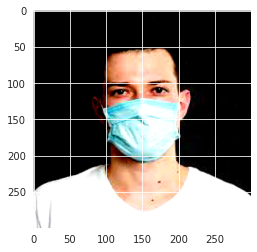

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


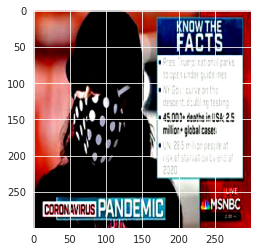

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


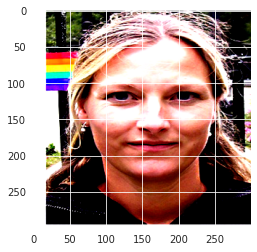

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


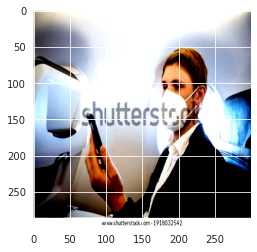

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


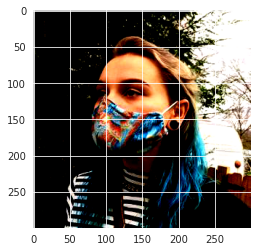

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


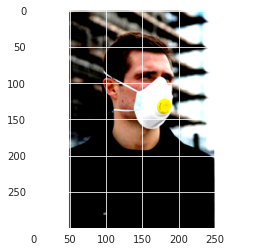

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


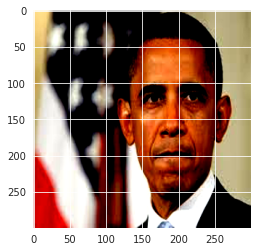

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


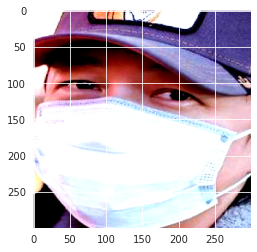

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


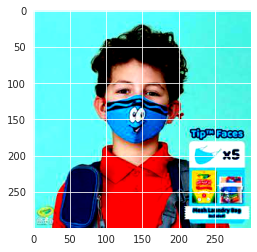

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


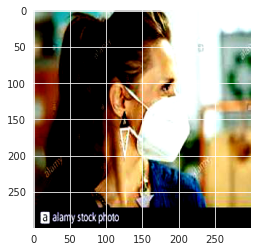

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


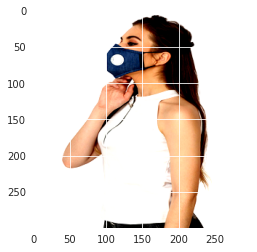

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


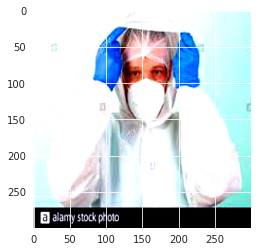

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


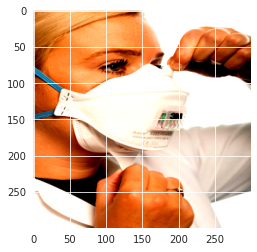

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


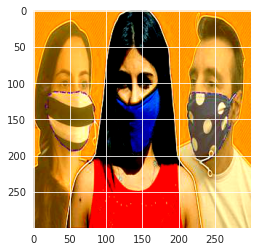

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


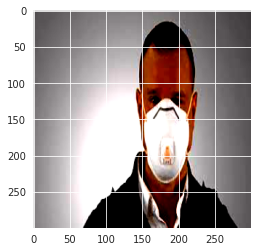

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


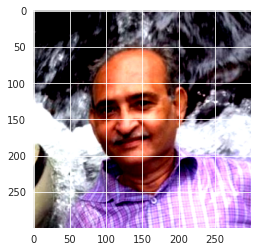

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


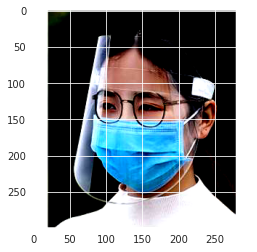

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


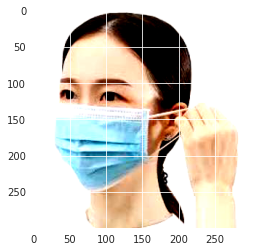

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


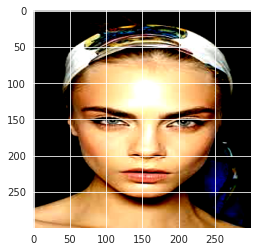

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


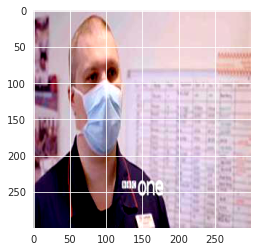

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


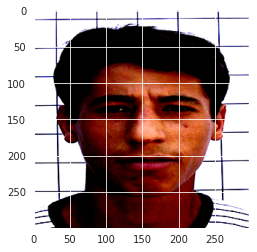

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


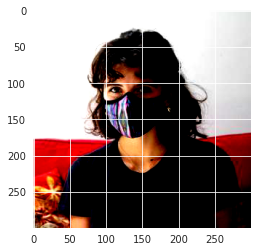

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


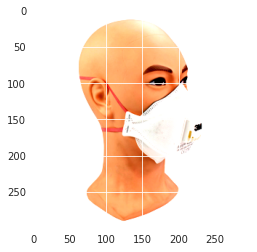

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


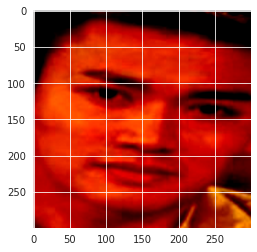

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


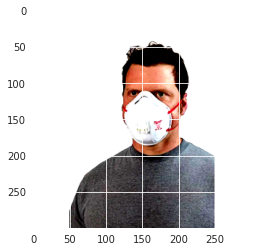

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


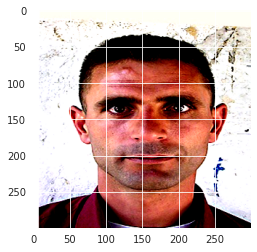

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


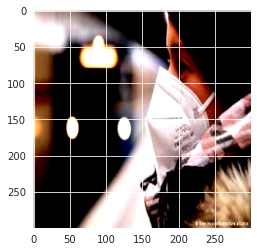

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


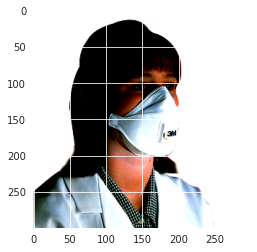

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


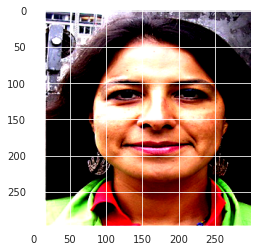

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


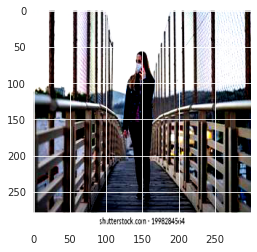

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


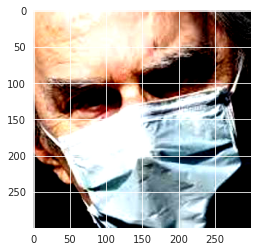

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


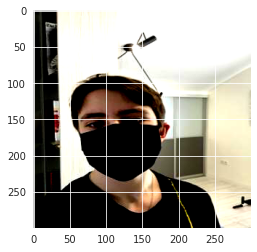

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


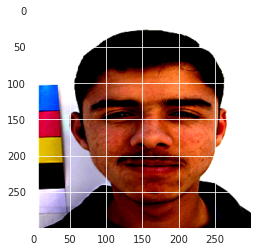

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


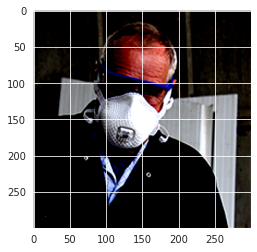

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


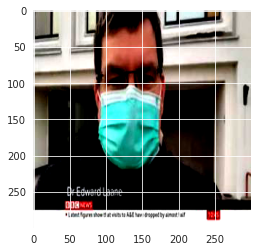

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


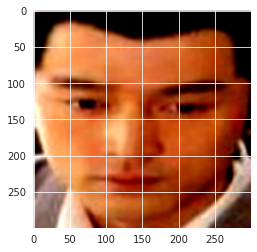

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


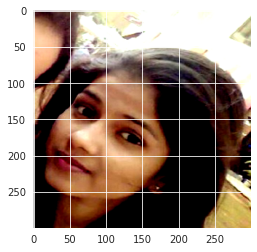

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


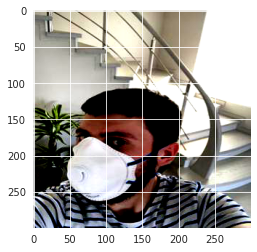

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


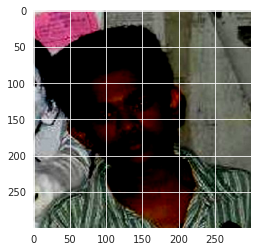

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


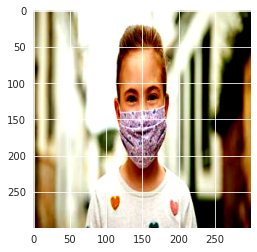

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


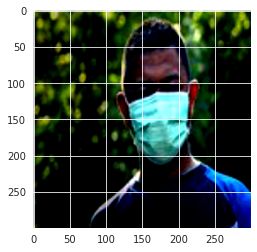

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


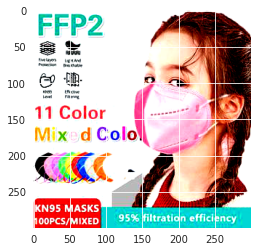

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


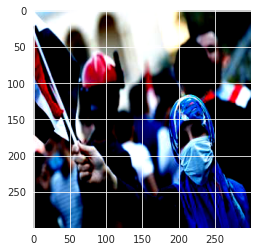

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


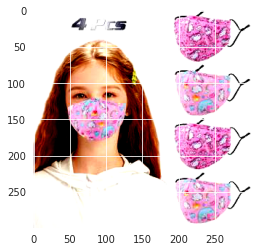

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


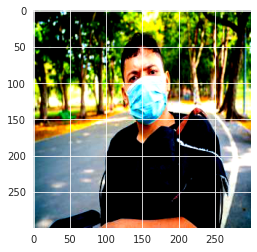

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


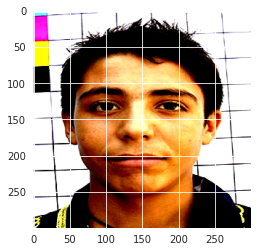

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


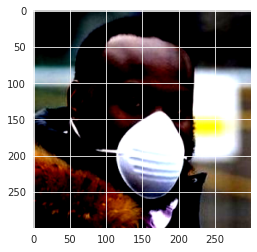

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


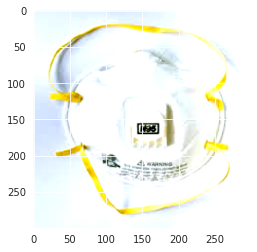

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


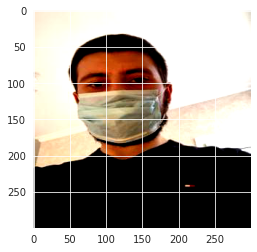

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


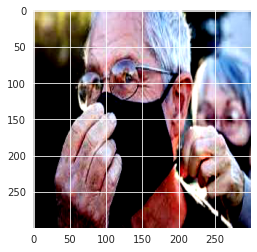

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


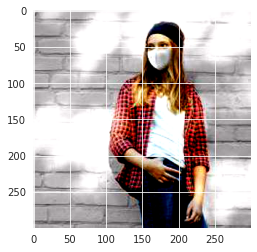

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


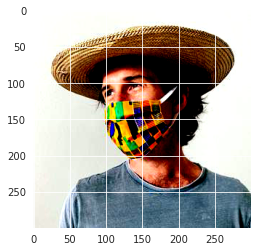

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


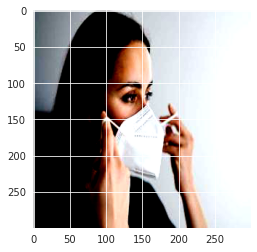

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


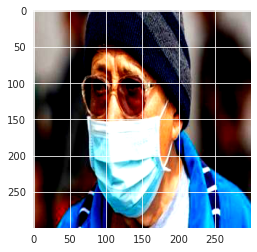

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


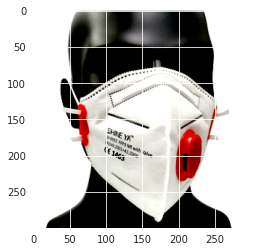

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


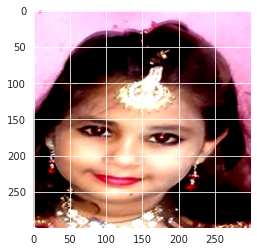

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


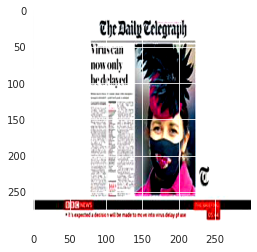

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


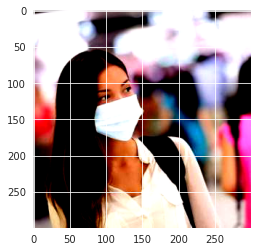

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


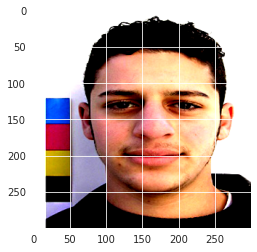

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


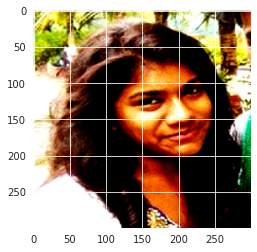

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


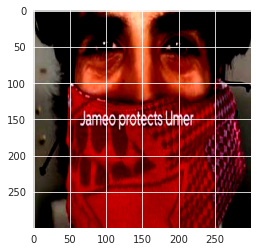

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


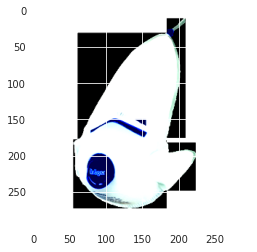

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


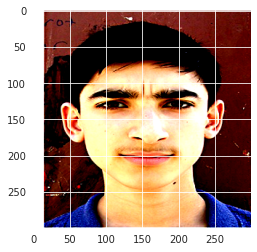

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


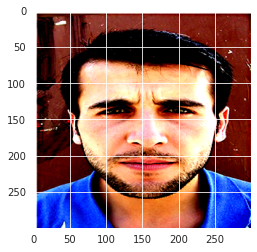

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


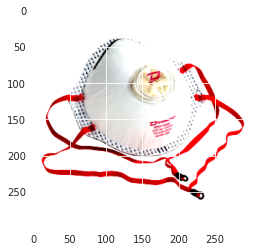

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


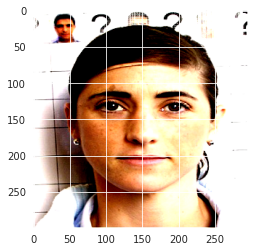

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


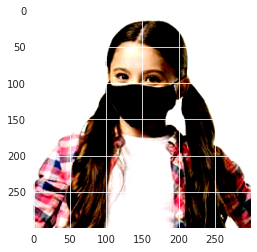

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


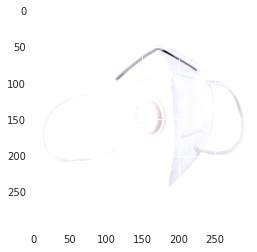

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


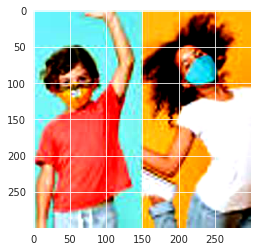

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


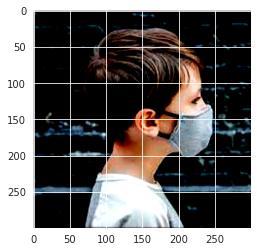

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


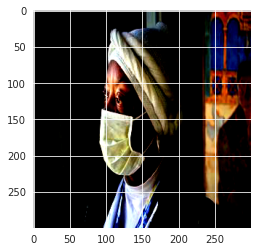

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


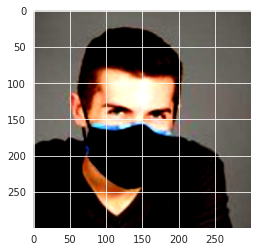

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


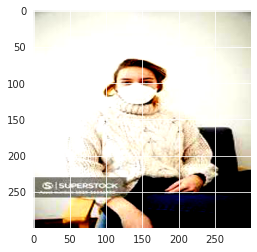

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


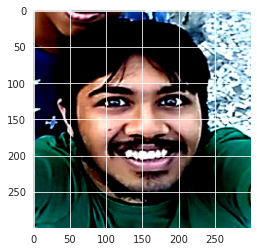

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


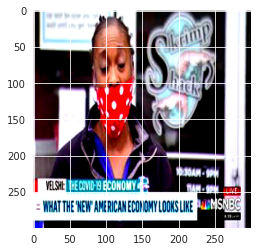

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


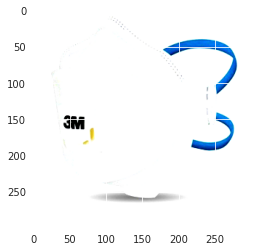

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


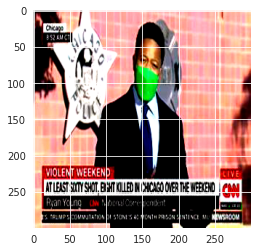

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


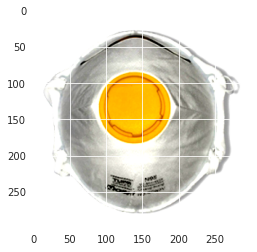

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


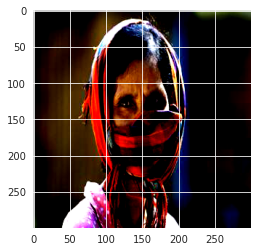

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


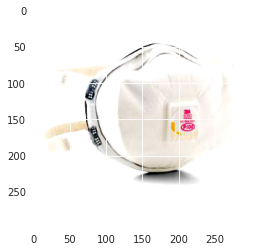

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


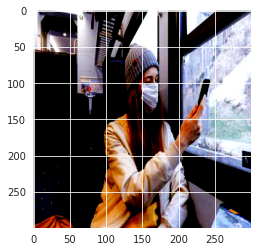

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


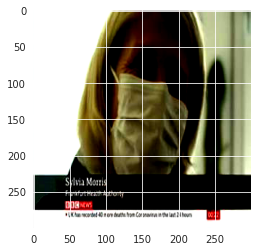

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


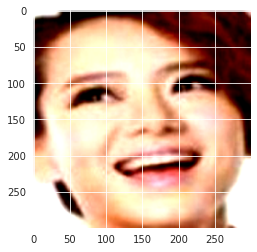

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


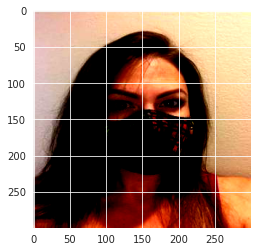

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


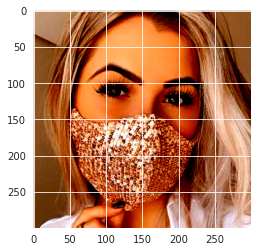

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


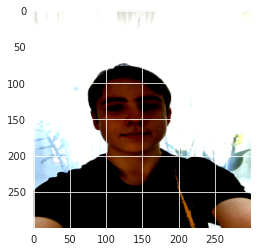

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


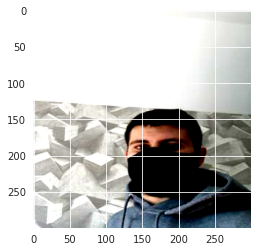

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


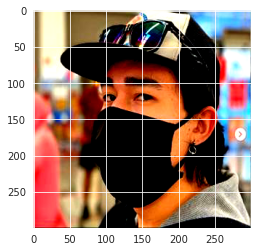

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


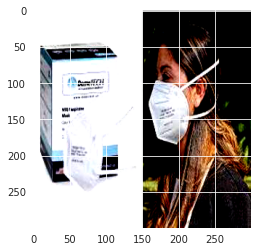

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


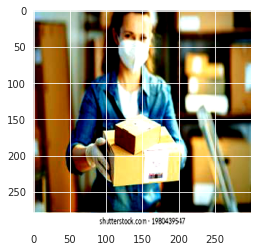

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


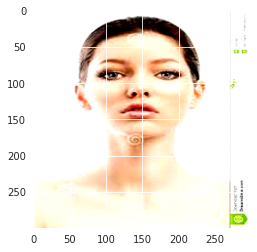

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


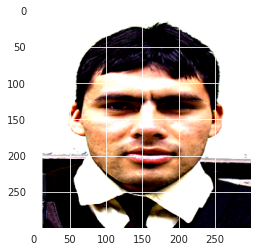

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


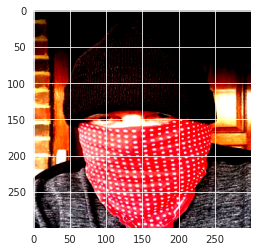

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


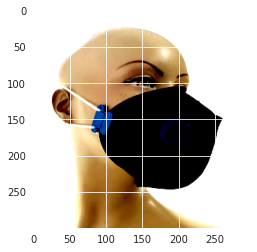

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


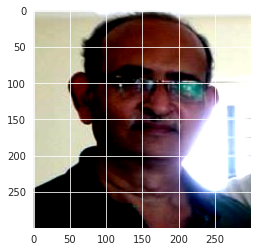

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


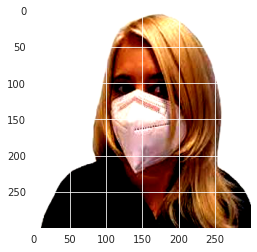

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


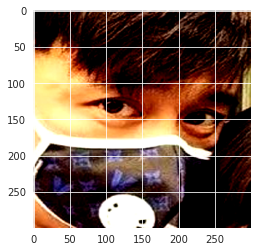

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


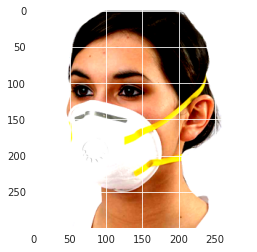

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


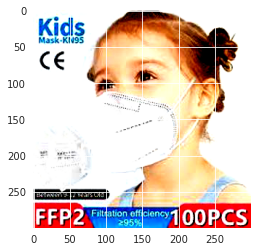

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


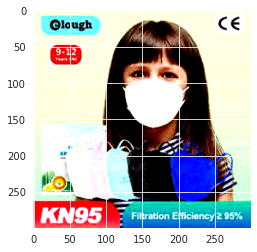

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


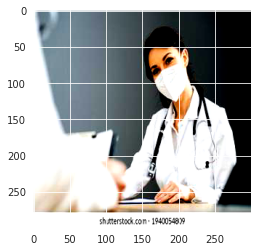

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


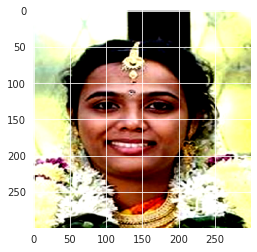

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


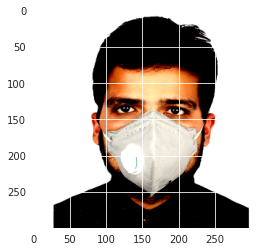

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


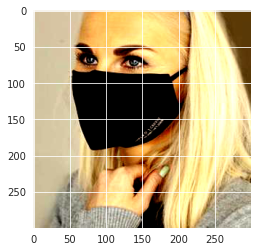

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


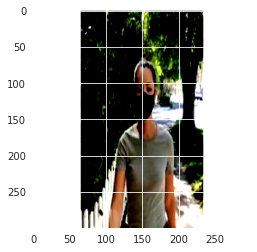

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


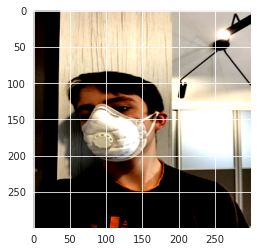

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


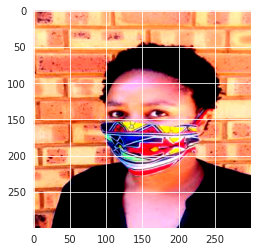

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


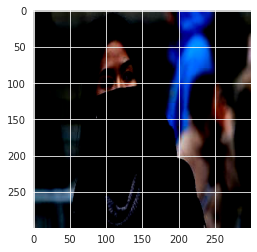

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


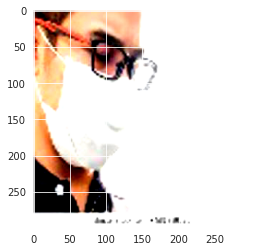

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


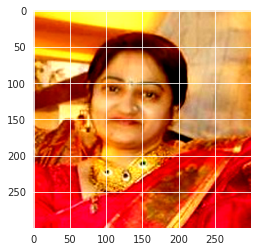

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


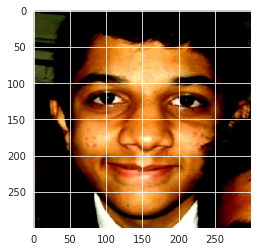

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


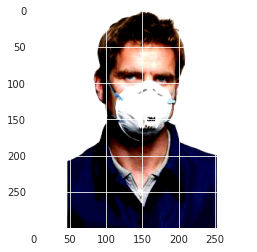

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


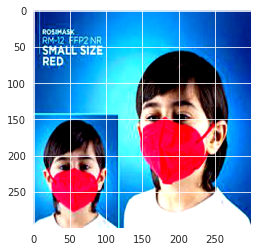

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


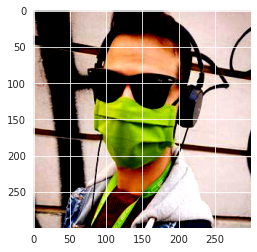

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


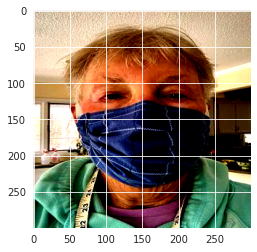

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


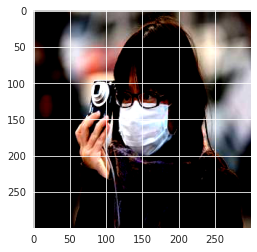

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


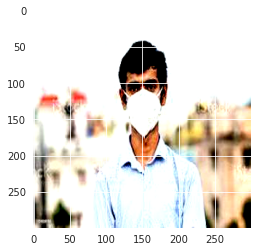

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


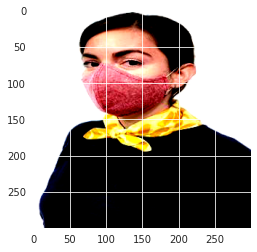

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


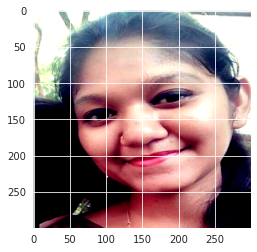

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


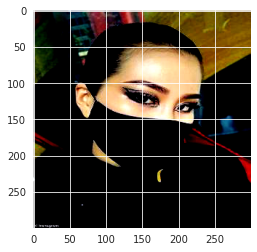

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


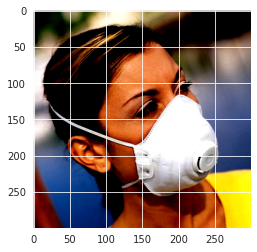

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


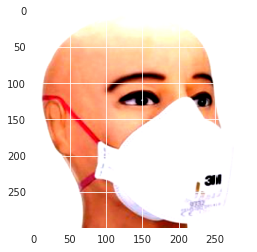

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


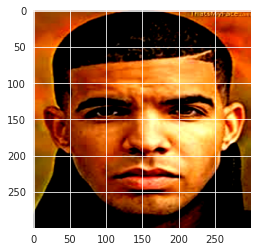

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


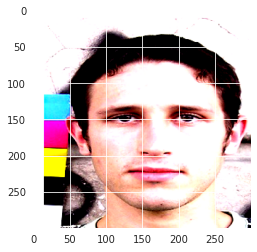

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


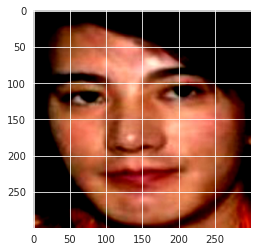

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


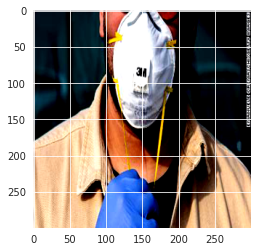

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


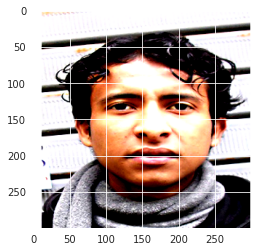

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


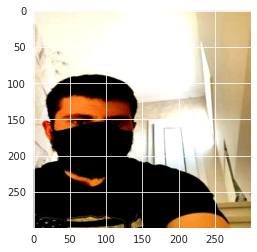

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


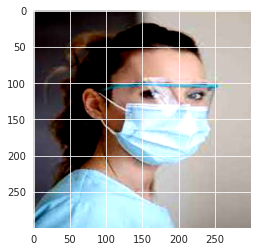

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


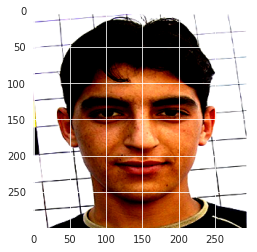

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


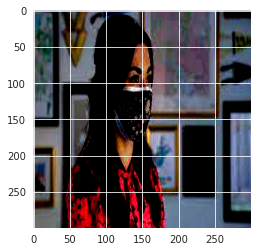

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


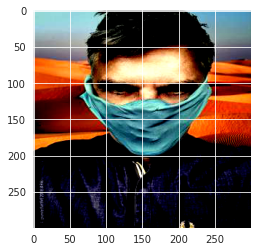

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


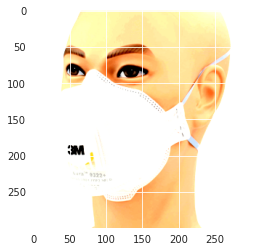

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


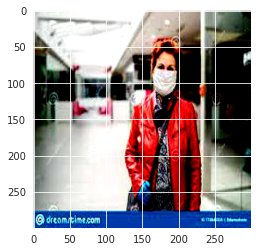

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


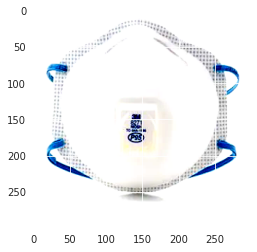

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


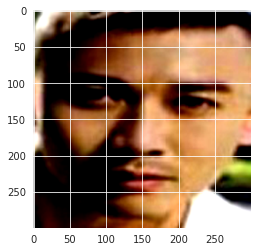

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


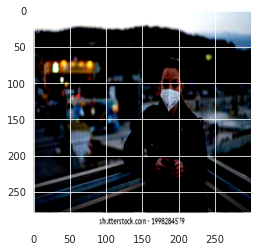

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


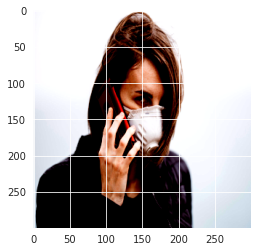

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


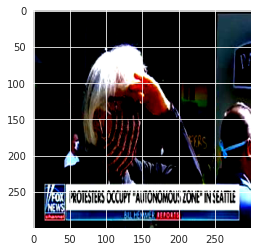

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


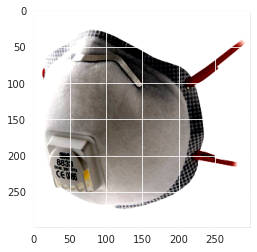

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


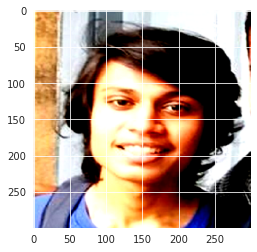

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


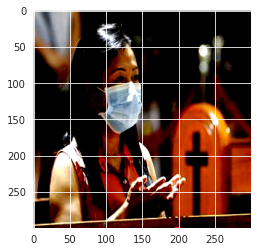

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


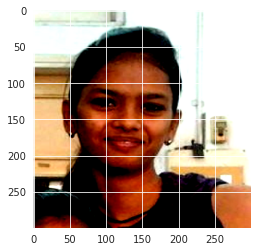

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


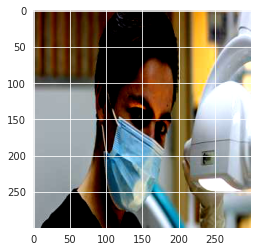

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


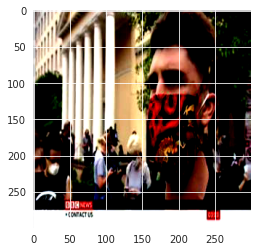

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


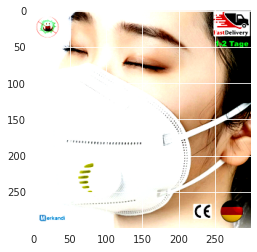

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


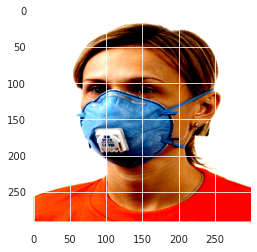

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


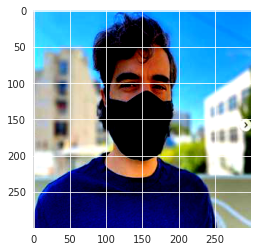

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


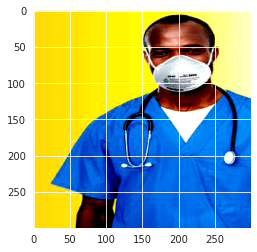

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


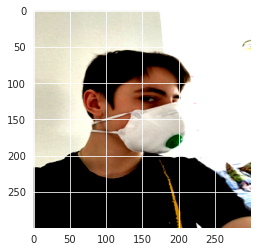

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


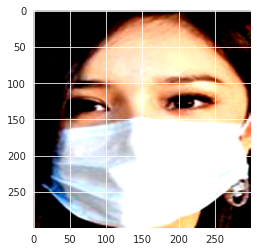

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


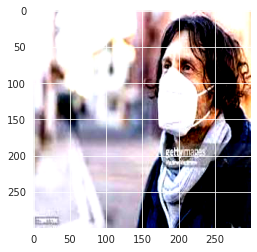

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


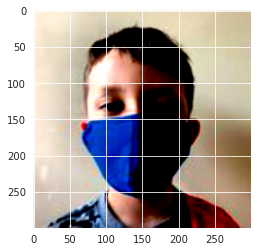

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


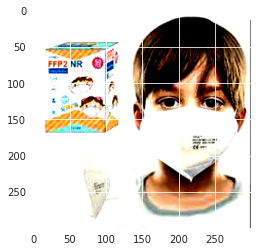

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


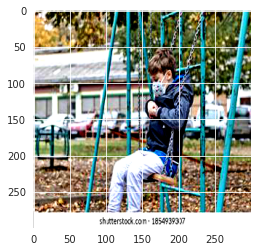

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


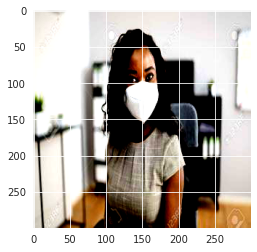

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


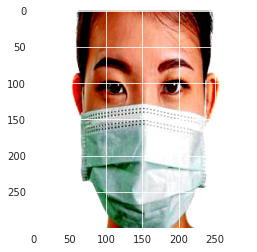

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


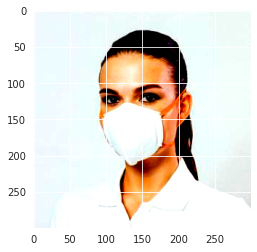

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


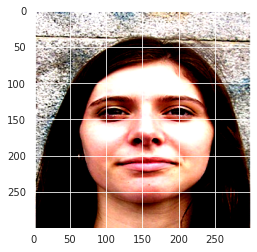

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


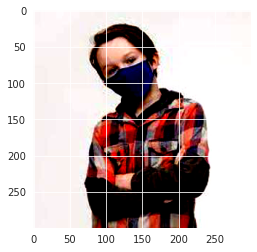

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


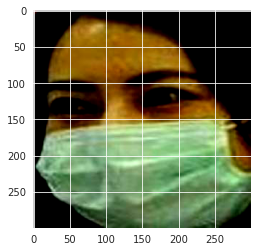

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


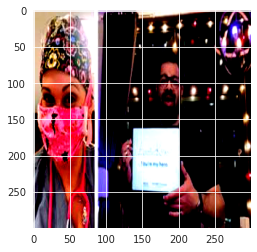

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


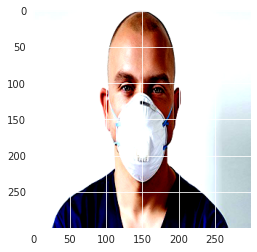

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


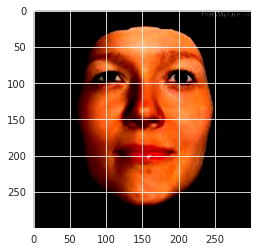

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


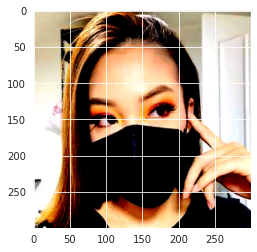

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


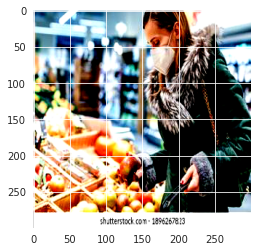

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


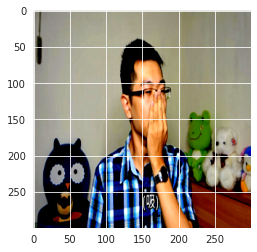

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


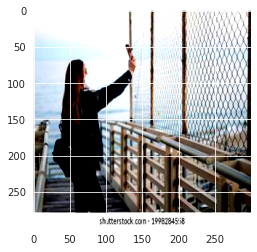

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


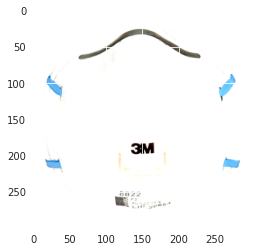

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


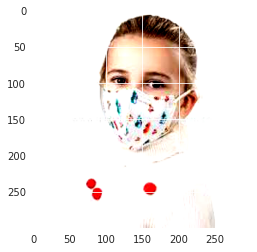

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


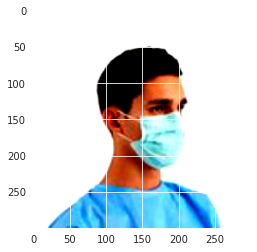

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


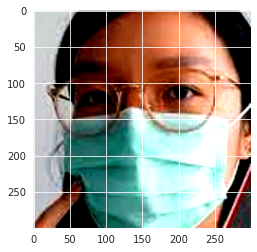

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


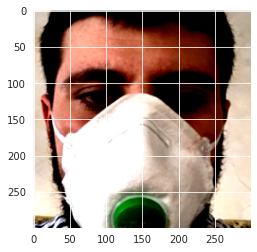

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


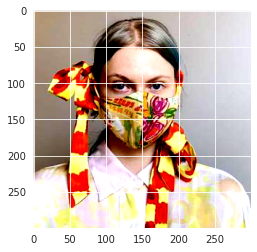

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


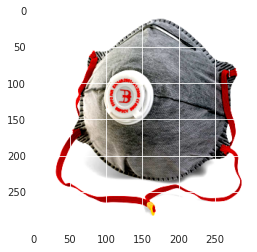

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


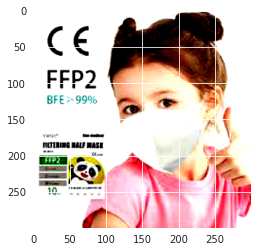

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


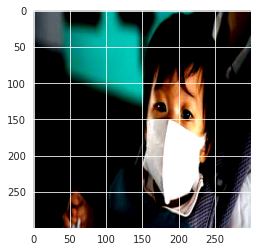

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


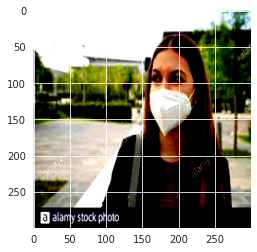

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


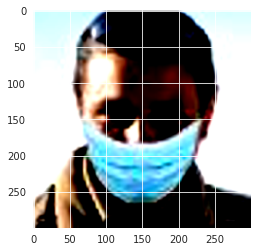

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


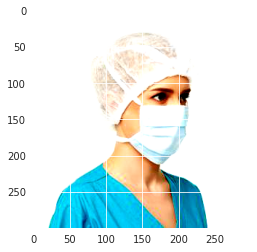

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


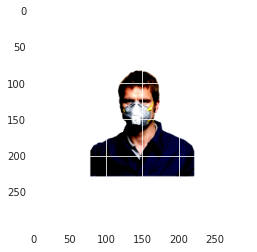

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


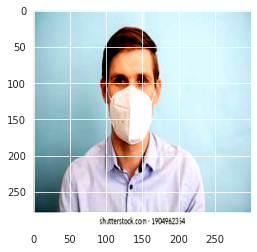

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


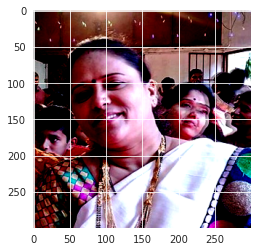

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


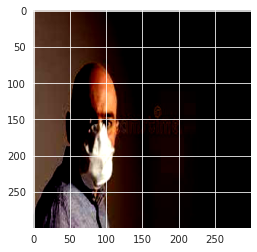

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


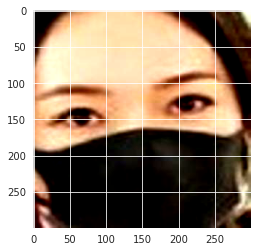

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


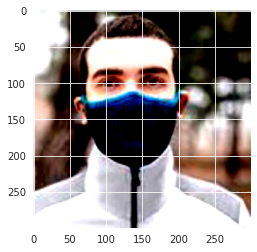

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


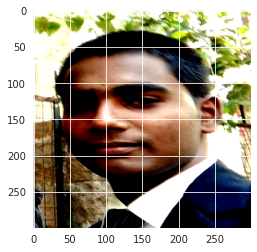

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


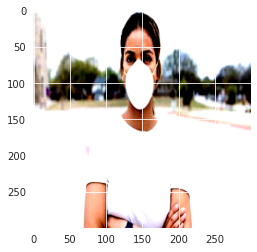

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


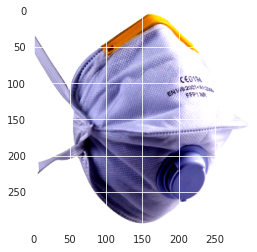

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


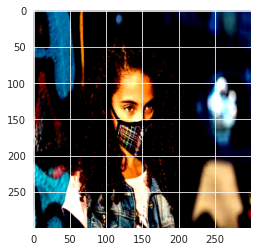

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


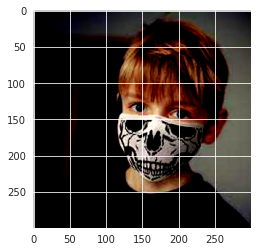

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


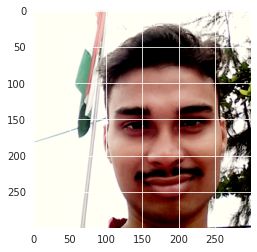

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


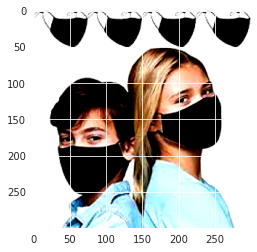

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


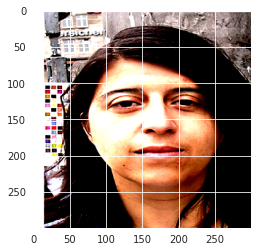

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


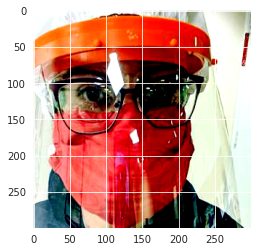

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


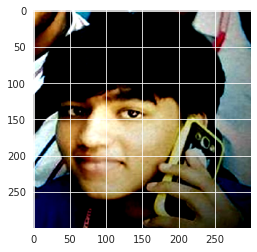

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


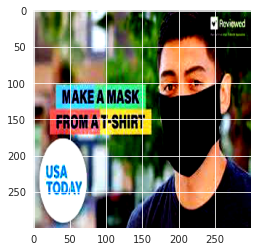

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


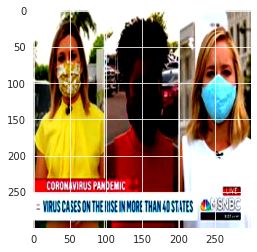

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


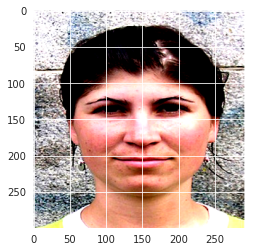

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


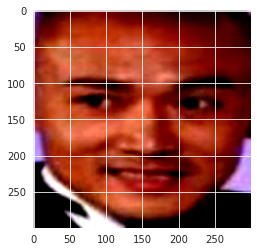

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


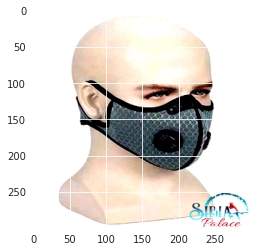

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is False!


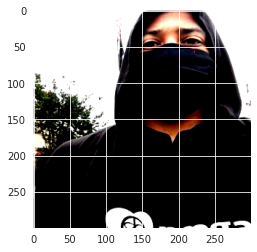

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


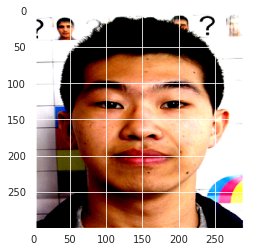

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Classification is correct!


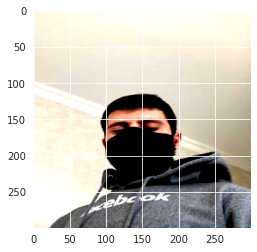

Classification is False!


In [24]:
y_pred_list = []
y_true_list = []

TGREEN = '\033[1;37;42m'
TRED = '\033[1;37;41m'

cnn_model.eval()
with torch.no_grad():
    for x, y in tqdm(test_loader):
        x, y = x.to(gpu), y.to(gpu)

        img_x = utils.make_grid(x)

        y_test_pred = cnn_model(x)
        _, y_pred = torch.max(y_test_pred, dim=1)

        y_pred_list.append(y_pred.cpu().numpy())
        y_true_list.append(y.cpu().numpy())

        # Print out test images with their label
        plt.imshow(img_x.cpu().permute(1, 2, 0) + 0.3)
        plt.show()
        if y_pred == y.cpu().numpy()[0]:
          print(TGREEN + "Classification is correct!")
        else:
          print(TRED + "Classification is False!")

y_pred_list = [i[0][0][0] for i in y_pred_list]
y_true_list = [i[0] for i in y_true_list]

#### **4.1. Comparing test results**

In [25]:
print('---------------------------- /CLASSIFICATION REPORTS\ -------------------------\n')
print(classification_report(y_true_list, y_pred_list, zero_division=0))
print('----------------------------- /CONFUSION MATRIX\ ----------------------------\n')
print(confusion_matrix(y_true_list, y_pred_list))
print('\n------------------------------- /Accuracy Score\ -------------------------------\n')
print(f'{accuracy_score(y_true_list, y_pred_list):.3f}')

---------------------------- /CLASSIFICATION REPORTS\ -------------------------

              precision    recall  f1-score   support

           0       0.78      0.80      0.79       104
           1       0.74      0.65      0.69        89
           2       0.60      0.63      0.61        87
           3       0.88      0.97      0.93       117
           4       0.67      0.59      0.63        78

    accuracy                           0.75       475
   macro avg       0.73      0.73      0.73       475
weighted avg       0.75      0.75      0.75       475

----------------------------- /CONFUSION MATRIX\ ----------------------------

[[ 83   1  11   3   6]
 [ 10  58  11   5   5]
 [  7  10  55   4  11]
 [  1   1   0 114   1]
 [  6   8  15   3  46]]

------------------------------- /Accuracy Score\ -------------------------------

0.749


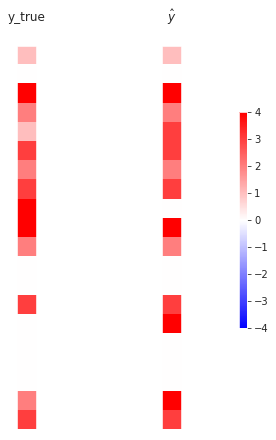

In [26]:
tensor_dict = {
    'y_true': torch.FloatTensor(y_true_list[: 20]),
    '$\hat{y}$': torch.FloatTensor(y_pred_list[: 20])
    }

plt_torch_test_acc(tensor_dict)

### **5. Bias Analysis**

In [27]:
image_transforms = transforms.Compose(
    [transforms.Resize((300, 300)),
     transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

bias_dir = os.path.join(root_dir, 'bias')

# For each bias category
for cat in os.listdir(bias_dir):
  cat_dir = os.path.join(bias_dir, cat)

  # For each class/label
  for label in os.listdir(cat_dir):
    label_dir = os.path.join(cat_dir, label)

    test_set = ImageFolder(root=label_dir, transform=image_transforms)
    test_loader = DataLoader(dataset=test_set, batch_size=1, num_workers=workers)
    y_pred_list = []
    y_true_list = []

    cnn_model.to(gpu)
    cnn_model.eval()
    with torch.no_grad():
        for x, y in tqdm(test_loader):
            x, y = x.to(gpu), y.to(gpu)

            img_x = utils.make_grid(x)

            y_test_pred = cnn_model(x)
            _, y_pred = torch.max(y_test_pred, dim=1)

            y_pred_list.append(y_pred.cpu().numpy())
            y_true_list.append(y.cpu().numpy())

            # Print out test images with their label
            # plt.imshow(img_x.cpu().permute(1, 2, 0) + 0.3)
            # plt.show()
            # if y_pred == y.cpu().numpy()[0]:
            #   print(TGREEN + "The prediction is True!")
            # else:
            #   print(TRED + "The prediction is False!")

    y_pred_list = [i[0][0][0] for i in y_pred_list]
    y_true_list = [i[0] for i in y_true_list]
    if cat == 'gender':
      print(f'____ / CLASSIFICATION REPORTS for Gender Category in {label} Class \ ____\n')
    else:
      print(f'____ / CLASSIFICATION REPORTS for Race Category in {label} Class \ ____\n')
    
    print(classification_report(y_true_list, y_pred_list, zero_division=0))
    print('-------------------------------- /CONFUSION MATRIX\ --------------------------------\n')
    print(confusion_matrix(y_true_list, y_pred_list))
    print('\n------------------------------- /Accuracy Score\ -------------------------------\n')
    print(f'{accuracy_score(y_true_list, y_pred_list):.3f}')

  0%|          | 0/219 [00:00<?, ?it/s]

____ / CLASSIFICATION REPORTS for Gender Category in n95 Class \ ____

              precision    recall  f1-score   support

           0       0.45      0.08      0.14       109
           1       0.66      0.26      0.38       110
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0

    accuracy                           0.17       219
   macro avg       0.22      0.07      0.10       219
weighted avg       0.56      0.17      0.26       219

-------------------------------- /CONFUSION MATRIX\ --------------------------------

[[ 9 15 38 16 31]
 [11 29 30 11 29]
 [ 0  0  0  0  0]
 [ 0  0  0  0  0]
 [ 0  0  0  0  0]]

------------------------------- /Accuracy Score\ -------------------------------

0.174


  0%|          | 0/341 [00:00<?, ?it/s]

____ / CLASSIFICATION REPORTS for Gender Category in nfm Class \ ____

              precision    recall  f1-score   support

           0       0.21      0.03      0.06       125
           1       0.50      0.02      0.04       216
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0

    accuracy                           0.02       341
   macro avg       0.14      0.01      0.02       341
weighted avg       0.39      0.02      0.04       341

-------------------------------- /CONFUSION MATRIX\ --------------------------------

[[  4   4   1 115   1]
 [ 15   4   2 194   1]
 [  0   0   0   0   0]
 [  0   0   0   0   0]
 [  0   0   0   0   0]]

------------------------------- /Accuracy Score\ -------------------------------

0.023


  0%|          | 0/97 [00:00<?, ?it/s]

____ / CLASSIFICATION REPORTS for Gender Category in n95v Class \ ____

              precision    recall  f1-score   support

           0       0.71      0.22      0.33        46
           1       0.50      0.08      0.14        51
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0

    accuracy                           0.14        97
   macro avg       0.24      0.06      0.09        97
weighted avg       0.60      0.14      0.23        97

-------------------------------- /CONFUSION MATRIX\ --------------------------------

[[10  4 16  7  9]
 [ 4  4 22 11 10]
 [ 0  0  0  0  0]
 [ 0  0  0  0  0]
 [ 0  0  0  0  0]]

------------------------------- /Accuracy Score\ -------------------------------

0.144


  0%|          | 0/341 [00:00<?, ?it/s]

____ / CLASSIFICATION REPORTS for Gender Category in srg Class \ ____

              precision    recall  f1-score   support

           0       0.42      0.09      0.14       161
           1       0.43      0.06      0.10       180
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0

    accuracy                           0.07       341
   macro avg       0.17      0.03      0.05       341
weighted avg       0.43      0.07      0.12       341

-------------------------------- /CONFUSION MATRIX\ --------------------------------

[[ 14  13  17  18  99]
 [ 19  10  22  16 113]
 [  0   0   0   0   0]
 [  0   0   0   0   0]
 [  0   0   0   0   0]]

------------------------------- /Accuracy Score\ -------------------------------

0.070


  0%|          | 0/373 [00:00<?, ?it/s]

____ / CLASSIFICATION REPORTS for Gender Category in cloth Class \ ____

              precision    recall  f1-score   support

           0       0.45      0.46      0.46       185
           1       0.32      0.04      0.07       188
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0

    accuracy                           0.25       373
   macro avg       0.15      0.10      0.10       373
weighted avg       0.38      0.25      0.26       373

-------------------------------- /CONFUSION MATRIX\ --------------------------------

[[ 86  15  23  27  34]
 [107   7  24  19  31]
 [  0   0   0   0   0]
 [  0   0   0   0   0]
 [  0   0   0   0   0]]

------------------------------- /Accuracy Score\ -------------------------------

0.249


  0%|          | 0/341 [00:00<?, ?it/s]

____ / CLASSIFICATION REPORTS for Race Category in nfm Class \ ____

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        83
           1       0.88      0.03      0.05       258
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0

    accuracy                           0.02       341
   macro avg       0.17      0.01      0.01       341
weighted avg       0.66      0.02      0.04       341

-------------------------------- /CONFUSION MATRIX\ --------------------------------

[[  0   1   1  81   0]
 [ 19   7   3 227   2]
 [  0   0   0   0   0]
 [  0   0   0   0   0]
 [  0   0   0   0   0]]

------------------------------- /Accuracy Score\ -------------------------------

0.021


  0%|          | 0/97 [00:00<?, ?it/s]

____ / CLASSIFICATION REPORTS for Race Category in n95v Class \ ____

              precision    recall  f1-score   support

           0       0.81      0.17      0.28        76
           1       0.25      0.10      0.14        21
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0

    accuracy                           0.15        97
   macro avg       0.21      0.05      0.08        97
weighted avg       0.69      0.15      0.25        97

-------------------------------- /CONFUSION MATRIX\ --------------------------------

[[13  6 27 15 15]
 [ 3  2 13  2  1]
 [ 0  0  0  0  0]
 [ 0  0  0  0  0]
 [ 0  0  0  0  0]]

------------------------------- /Accuracy Score\ -------------------------------

0.155


  0%|          | 0/219 [00:00<?, ?it/s]

____ / CLASSIFICATION REPORTS for Race Category in n95 Class \ ____

              precision    recall  f1-score   support

           0       0.83      0.09      0.16       174
           1       0.41      0.40      0.40        45
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0

    accuracy                           0.15       219
   macro avg       0.25      0.10      0.11       219
weighted avg       0.75      0.15      0.21       219

-------------------------------- /CONFUSION MATRIX\ --------------------------------

[[15 26 54 26 53]
 [ 3 18 12  2 10]
 [ 0  0  0  0  0]
 [ 0  0  0  0  0]
 [ 0  0  0  0  0]]

------------------------------- /Accuracy Score\ -------------------------------

0.151


  0%|          | 0/341 [00:00<?, ?it/s]

____ / CLASSIFICATION REPORTS for Race Category in srg Class \ ____

              precision    recall  f1-score   support

           0       0.79      0.11      0.19       244
           1       0.39      0.09      0.15        97
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0

    accuracy                           0.10       341
   macro avg       0.24      0.04      0.07       341
weighted avg       0.68      0.10      0.18       341

-------------------------------- /CONFUSION MATRIX\ --------------------------------

[[ 26  14  32  30 142]
 [  7   9   7   4  70]
 [  0   0   0   0   0]
 [  0   0   0   0   0]
 [  0   0   0   0   0]]

------------------------------- /Accuracy Score\ -------------------------------

0.103


  0%|          | 0/373 [00:00<?, ?it/s]

____ / CLASSIFICATION REPORTS for Race Category in cloth Class \ ____

              precision    recall  f1-score   support

           0       0.33      0.36      0.35       178
           1       0.82      0.09      0.17       195
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0

    accuracy                           0.22       373
   macro avg       0.23      0.09      0.10       373
weighted avg       0.59      0.22      0.25       373

-------------------------------- /CONFUSION MATRIX\ --------------------------------

[[ 64   4  24  37  49]
 [129  18  23   9  16]
 [  0   0   0   0   0]
 [  0   0   0   0   0]
 [  0   0   0   0   0]]

------------------------------- /Accuracy Score\ -------------------------------

0.220


### **6. 10-Fold Cross Validation**

---------------------------
FOLD 1
---------------------------
Reset trainable parameters of layer = Conv2d(3, 512, kernel_size=(5, 5), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(512, 256, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(256, 128, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(128, 64, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(64, 5, kernel_size=(4, 4), stride=(2, 2))

Train Subsampler 

  0%|          | 0/20 [00:00<?, ?it/s]

Epochs 01: | Train Loss: 1.2462 | Train Accuracy: 50.46

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 1: 57 %
---------------------------
Epochs 02: | Train Loss: 0.9805 | Train Accuracy: 63.40

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 1: 61 %
---------------------------
Epochs 03: | Train Loss: 0.8677 | Train Accuracy: 66.85

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 1: 66 %
---------------------------
Epochs 04: | Train Loss: 0.7918 | Train Accuracy: 70.19

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 1: 68 %
---------------------------
Epochs 05: | Train Loss: 0.7244 | Train Accuracy: 74.00

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 1: 64 %
---------------------------
Epochs 06: | Train Loss: 0.6220 | Train Accuracy: 75.96

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 1: 63 %
---------------------------
Epochs 07: | Train Loss: 0.5799 | Train Accuracy: 79.53

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 1: 68 %
---------------------------
Epochs 08: | Train Loss: 0.5632 | Train Accuracy: 79.70

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 1: 73 %
---------------------------
Epochs 09: | Train Loss: 0.4714 | Train Accuracy: 82.99

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 1: 69 %
---------------------------
Epochs 10: | Train Loss: 0.4105 | Train Accuracy: 85.22

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 1: 71 %
---------------------------
Epochs 11: | Train Loss: 0.3542 | Train Accuracy: 87.63

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 1: 73 %
---------------------------
Epochs 12: | Train Loss: 0.3018 | Train Accuracy: 90.58

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 1: 74 %
---------------------------
Epochs 13: | Train Loss: 0.2542 | Train Accuracy: 91.61

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 1: 72 %
---------------------------
Epochs 14: | Train Loss: 0.2275 | Train Accuracy: 92.90

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 1: 75 %
---------------------------
Epochs 15: | Train Loss: 0.1942 | Train Accuracy: 94.18

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 1: 73 %
---------------------------
Epochs 16: | Train Loss: 0.1569 | Train Accuracy: 95.28

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 1: 76 %
---------------------------
Epochs 17: | Train Loss: 0.1375 | Train Accuracy: 96.14

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 1: 81 %
---------------------------
Epochs 18: | Train Loss: 0.1076 | Train Accuracy: 97.48

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 1: 78 %
---------------------------
Epochs 19: | Train Loss: 0.0899 | Train Accuracy: 97.70

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 1: 77 %
---------------------------
Epochs 20: | Train Loss: 0.0851 | Train Accuracy: 97.61

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 1: 79 %
---------------------------
FOLD 2
---------------------------
Reset trainable parameters of layer = Conv2d(3, 512, kernel_size=(5, 5), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(512, 256, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(256, 128, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(128, 64, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(64, 5, kernel_size=(4, 4), stride=

  0%|          | 0/20 [00:00<?, ?it/s]

Epochs 01: | Train Loss: 1.2308 | Train Accuracy: 50.68

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 2: 58 %
---------------------------
Epochs 02: | Train Loss: 0.9648 | Train Accuracy: 63.93

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 2: 71 %
---------------------------
Epochs 03: | Train Loss: 0.8187 | Train Accuracy: 69.16

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 2: 67 %
---------------------------
Epochs 04: | Train Loss: 0.7918 | Train Accuracy: 70.17

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 2: 70 %
---------------------------
Epochs 05: | Train Loss: 0.7299 | Train Accuracy: 72.73

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 2: 69 %
---------------------------
Epochs 06: | Train Loss: 0.6520 | Train Accuracy: 75.68

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 2: 66 %
---------------------------
Epochs 07: | Train Loss: 0.5875 | Train Accuracy: 78.70

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 2: 72 %
---------------------------
Epochs 08: | Train Loss: 0.5523 | Train Accuracy: 79.74

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 2: 75 %
---------------------------
Epochs 09: | Train Loss: 0.4427 | Train Accuracy: 84.39

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 2: 71 %
---------------------------
Epochs 10: | Train Loss: 0.4082 | Train Accuracy: 86.12

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 2: 78 %
---------------------------
Epochs 11: | Train Loss: 0.3531 | Train Accuracy: 87.69

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 2: 68 %
---------------------------
Epochs 12: | Train Loss: 0.3024 | Train Accuracy: 89.26

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 2: 78 %
---------------------------
Epochs 13: | Train Loss: 0.2184 | Train Accuracy: 93.09

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 2: 75 %
---------------------------
Epochs 14: | Train Loss: 0.2010 | Train Accuracy: 93.64

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 2: 78 %
---------------------------
Epochs 15: | Train Loss: 0.1671 | Train Accuracy: 95.37

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 2: 75 %
---------------------------
Epochs 16: | Train Loss: 0.1472 | Train Accuracy: 95.91

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 2: 77 %
---------------------------
Epochs 17: | Train Loss: 0.1313 | Train Accuracy: 96.34

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 2: 75 %
---------------------------
Epochs 18: | Train Loss: 0.1012 | Train Accuracy: 97.51

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 2: 76 %
---------------------------
Epochs 19: | Train Loss: 0.0949 | Train Accuracy: 97.71

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 2: 75 %
---------------------------
Epochs 20: | Train Loss: 0.1041 | Train Accuracy: 97.26

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 2: 73 %
---------------------------
FOLD 3
---------------------------
Reset trainable parameters of layer = Conv2d(3, 512, kernel_size=(5, 5), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(512, 256, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(256, 128, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(128, 64, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(64, 5, kernel_size=(4, 4), stride=

  0%|          | 0/20 [00:00<?, ?it/s]

Epochs 01: | Train Loss: 1.2565 | Train Accuracy: 51.17

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 3: 52 %
---------------------------
Epochs 02: | Train Loss: 1.0295 | Train Accuracy: 60.12

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 3: 63 %
---------------------------
Epochs 03: | Train Loss: 0.9180 | Train Accuracy: 65.23

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 3: 66 %
---------------------------
Epochs 04: | Train Loss: 0.7804 | Train Accuracy: 69.75

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 3: 68 %
---------------------------
Epochs 05: | Train Loss: 0.7408 | Train Accuracy: 72.16

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 3: 63 %
---------------------------
Epochs 06: | Train Loss: 0.6834 | Train Accuracy: 74.74

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 3: 71 %
---------------------------
Epochs 07: | Train Loss: 0.6044 | Train Accuracy: 78.09

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 3: 73 %
---------------------------
Epochs 08: | Train Loss: 0.5315 | Train Accuracy: 80.60

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 3: 72 %
---------------------------
Epochs 09: | Train Loss: 0.4557 | Train Accuracy: 83.71

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 3: 73 %
---------------------------
Epochs 10: | Train Loss: 0.4100 | Train Accuracy: 85.51

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 3: 75 %
---------------------------
Epochs 11: | Train Loss: 0.3574 | Train Accuracy: 86.79

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 3: 75 %
---------------------------
Epochs 12: | Train Loss: 0.3028 | Train Accuracy: 90.19

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 3: 68 %
---------------------------
Epochs 13: | Train Loss: 0.2452 | Train Accuracy: 92.51

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 3: 78 %
---------------------------
Epochs 14: | Train Loss: 0.2048 | Train Accuracy: 93.50

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 3: 75 %
---------------------------
Epochs 15: | Train Loss: 0.1670 | Train Accuracy: 94.83

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 3: 75 %
---------------------------
Epochs 16: | Train Loss: 0.1593 | Train Accuracy: 95.25

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 3: 75 %
---------------------------
Epochs 17: | Train Loss: 0.1217 | Train Accuracy: 96.84

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 3: 76 %
---------------------------
Epochs 18: | Train Loss: 0.0815 | Train Accuracy: 98.51

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 3: 75 %
---------------------------
Epochs 19: | Train Loss: 0.0781 | Train Accuracy: 98.28

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 3: 75 %
---------------------------
Epochs 20: | Train Loss: 0.0611 | Train Accuracy: 98.37

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 3: 76 %
---------------------------
FOLD 4
---------------------------
Reset trainable parameters of layer = Conv2d(3, 512, kernel_size=(5, 5), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(512, 256, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(256, 128, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(128, 64, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(64, 5, kernel_size=(4, 4), stride=

  0%|          | 0/20 [00:00<?, ?it/s]

Epochs 01: | Train Loss: 1.2427 | Train Accuracy: 50.36

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 4: 59 %
---------------------------
Epochs 02: | Train Loss: 1.0311 | Train Accuracy: 60.14

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 4: 63 %
---------------------------
Epochs 03: | Train Loss: 0.8470 | Train Accuracy: 68.00

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 4: 65 %
---------------------------
Epochs 04: | Train Loss: 0.8093 | Train Accuracy: 69.41

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 4: 60 %
---------------------------
Epochs 05: | Train Loss: 0.7156 | Train Accuracy: 73.67

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 4: 64 %
---------------------------
Epochs 06: | Train Loss: 0.6541 | Train Accuracy: 76.08

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 4: 62 %
---------------------------
Epochs 07: | Train Loss: 0.6135 | Train Accuracy: 77.16

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 4: 72 %
---------------------------
Epochs 08: | Train Loss: 0.5073 | Train Accuracy: 81.53

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 4: 73 %
---------------------------
Epochs 09: | Train Loss: 0.4554 | Train Accuracy: 84.17

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 4: 74 %
---------------------------
Epochs 10: | Train Loss: 0.3979 | Train Accuracy: 86.42

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 4: 73 %
---------------------------
Epochs 11: | Train Loss: 0.3296 | Train Accuracy: 88.13

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 4: 78 %
---------------------------
Epochs 12: | Train Loss: 0.2821 | Train Accuracy: 90.58

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 4: 70 %
---------------------------
Epochs 13: | Train Loss: 0.2507 | Train Accuracy: 91.64

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 4: 75 %
---------------------------
Epochs 14: | Train Loss: 0.2407 | Train Accuracy: 91.94

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 4: 71 %
---------------------------
Epochs 15: | Train Loss: 0.1883 | Train Accuracy: 94.04

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 4: 72 %
---------------------------
Epochs 16: | Train Loss: 0.1590 | Train Accuracy: 95.32

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 4: 75 %
---------------------------
Epochs 17: | Train Loss: 0.0988 | Train Accuracy: 97.67

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 4: 72 %
---------------------------
Epochs 18: | Train Loss: 0.1165 | Train Accuracy: 96.71

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 4: 72 %
---------------------------
Epochs 19: | Train Loss: 0.0915 | Train Accuracy: 97.85

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 4: 72 %
---------------------------
Epochs 20: | Train Loss: 0.1005 | Train Accuracy: 97.40

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 4: 72 %
---------------------------
FOLD 5
---------------------------
Reset trainable parameters of layer = Conv2d(3, 512, kernel_size=(5, 5), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(512, 256, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(256, 128, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(128, 64, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(64, 5, kernel_size=(4, 4), stride=

  0%|          | 0/20 [00:00<?, ?it/s]

Epochs 01: | Train Loss: 1.2236 | Train Accuracy: 51.10

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 5: 54 %
---------------------------
Epochs 02: | Train Loss: 0.9782 | Train Accuracy: 61.75

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 5: 60 %
---------------------------
Epochs 03: | Train Loss: 0.8888 | Train Accuracy: 66.78

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 5: 64 %
---------------------------
Epochs 04: | Train Loss: 0.7817 | Train Accuracy: 70.19

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 5: 64 %
---------------------------
Epochs 05: | Train Loss: 0.7322 | Train Accuracy: 72.17

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 5: 62 %
---------------------------
Epochs 06: | Train Loss: 0.6609 | Train Accuracy: 75.19

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 5: 67 %
---------------------------
Epochs 07: | Train Loss: 0.5842 | Train Accuracy: 78.86

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 5: 75 %
---------------------------
Epochs 08: | Train Loss: 0.5181 | Train Accuracy: 80.91

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 5: 71 %
---------------------------
Epochs 09: | Train Loss: 0.4278 | Train Accuracy: 85.18

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 5: 65 %
---------------------------
Epochs 10: | Train Loss: 0.3714 | Train Accuracy: 87.33

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 5: 74 %
---------------------------
Epochs 11: | Train Loss: 0.2989 | Train Accuracy: 89.88

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 5: 75 %
---------------------------
Epochs 12: | Train Loss: 0.2369 | Train Accuracy: 92.39

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 5: 74 %
---------------------------
Epochs 13: | Train Loss: 0.2041 | Train Accuracy: 93.91

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 5: 74 %
---------------------------
Epochs 14: | Train Loss: 0.1992 | Train Accuracy: 94.17

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 5: 73 %
---------------------------
Epochs 15: | Train Loss: 0.1509 | Train Accuracy: 95.75

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 5: 73 %
---------------------------
Epochs 16: | Train Loss: 0.1344 | Train Accuracy: 95.71

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 5: 72 %
---------------------------
Epochs 17: | Train Loss: 0.1122 | Train Accuracy: 96.91

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 5: 74 %
---------------------------
Epochs 18: | Train Loss: 0.0930 | Train Accuracy: 97.36

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 5: 75 %
---------------------------
Epochs 19: | Train Loss: 0.0850 | Train Accuracy: 98.01

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 5: 71 %
---------------------------
Epochs 20: | Train Loss: 0.1149 | Train Accuracy: 97.10

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 5: 74 %
---------------------------
FOLD 6
---------------------------
Reset trainable parameters of layer = Conv2d(3, 512, kernel_size=(5, 5), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(512, 256, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(256, 128, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(128, 64, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(64, 5, kernel_size=(4, 4), stride=

  0%|          | 0/20 [00:00<?, ?it/s]

Epochs 01: | Train Loss: 1.2736 | Train Accuracy: 50.26

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 6: 60 %
---------------------------
Epochs 02: | Train Loss: 1.0124 | Train Accuracy: 61.72

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 6: 62 %
---------------------------
Epochs 03: | Train Loss: 0.9050 | Train Accuracy: 65.71

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 6: 69 %
---------------------------
Epochs 04: | Train Loss: 0.7769 | Train Accuracy: 71.38

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 6: 65 %
---------------------------
Epochs 05: | Train Loss: 0.7091 | Train Accuracy: 73.36

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 6: 72 %
---------------------------
Epochs 06: | Train Loss: 0.6533 | Train Accuracy: 74.91

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 6: 67 %
---------------------------
Epochs 07: | Train Loss: 0.5938 | Train Accuracy: 78.63

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 6: 68 %
---------------------------
Epochs 08: | Train Loss: 0.5278 | Train Accuracy: 80.35

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 6: 71 %
---------------------------
Epochs 09: | Train Loss: 0.4647 | Train Accuracy: 83.19

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 6: 78 %
---------------------------
Epochs 10: | Train Loss: 0.4033 | Train Accuracy: 85.54

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 6: 72 %
---------------------------
Epochs 11: | Train Loss: 0.3446 | Train Accuracy: 87.87

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 6: 71 %
---------------------------
Epochs 12: | Train Loss: 0.2919 | Train Accuracy: 89.60

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 6: 72 %
---------------------------
Epochs 13: | Train Loss: 0.2364 | Train Accuracy: 92.91

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 6: 74 %
---------------------------
Epochs 14: | Train Loss: 0.2141 | Train Accuracy: 93.70

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 6: 75 %
---------------------------
Epochs 15: | Train Loss: 0.1639 | Train Accuracy: 95.29

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 6: 75 %
---------------------------
Epochs 16: | Train Loss: 0.1641 | Train Accuracy: 95.52

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 6: 74 %
---------------------------
Epochs 17: | Train Loss: 0.1175 | Train Accuracy: 96.88

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 6: 72 %
---------------------------
Epochs 18: | Train Loss: 0.0937 | Train Accuracy: 98.14

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 6: 75 %
---------------------------
Epochs 19: | Train Loss: 0.1076 | Train Accuracy: 96.60

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 6: 73 %
---------------------------
Epochs 20: | Train Loss: 0.0987 | Train Accuracy: 97.25

Starting testing


  0%|          | 0/229 [00:00<?, ?it/s]

Accuracy for fold 6: 75 %
---------------------------
FOLD 7
---------------------------
Reset trainable parameters of layer = Conv2d(3, 512, kernel_size=(5, 5), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(512, 256, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(256, 128, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(128, 64, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(64, 5, kernel_size=(4, 4), stride=

  0%|          | 0/20 [00:00<?, ?it/s]

Epochs 01: | Train Loss: 1.1964 | Train Accuracy: 52.78

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 7: 56 %
---------------------------
Epochs 02: | Train Loss: 0.9761 | Train Accuracy: 63.91

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 7: 65 %
---------------------------
Epochs 03: | Train Loss: 0.8417 | Train Accuracy: 69.29

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 7: 68 %
---------------------------
Epochs 04: | Train Loss: 0.7866 | Train Accuracy: 70.20

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 7: 66 %
---------------------------
Epochs 05: | Train Loss: 0.7128 | Train Accuracy: 73.43

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 7: 68 %
---------------------------
Epochs 06: | Train Loss: 0.6369 | Train Accuracy: 76.53

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 7: 68 %
---------------------------
Epochs 07: | Train Loss: 0.5878 | Train Accuracy: 78.23

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 7: 72 %
---------------------------
Epochs 08: | Train Loss: 0.5308 | Train Accuracy: 80.59

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 7: 70 %
---------------------------
Epochs 09: | Train Loss: 0.4396 | Train Accuracy: 83.50

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 7: 74 %
---------------------------
Epochs 10: | Train Loss: 0.3624 | Train Accuracy: 87.89

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 7: 75 %
---------------------------
Epochs 11: | Train Loss: 0.3255 | Train Accuracy: 88.58

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 7: 75 %
---------------------------
Epochs 12: | Train Loss: 0.2658 | Train Accuracy: 91.41

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 7: 74 %
---------------------------
Epochs 13: | Train Loss: 0.2172 | Train Accuracy: 93.32

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 7: 71 %
---------------------------
Epochs 14: | Train Loss: 0.1831 | Train Accuracy: 95.09

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 7: 75 %
---------------------------
Epochs 15: | Train Loss: 0.1527 | Train Accuracy: 95.81

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 7: 76 %
---------------------------
Epochs 16: | Train Loss: 0.1228 | Train Accuracy: 96.53

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 7: 73 %
---------------------------
Epochs 17: | Train Loss: 0.1109 | Train Accuracy: 97.25

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 7: 73 %
---------------------------
Epochs 18: | Train Loss: 0.1022 | Train Accuracy: 97.06

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 7: 75 %
---------------------------
Epochs 19: | Train Loss: 0.0962 | Train Accuracy: 97.50

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 7: 76 %
---------------------------
Epochs 20: | Train Loss: 0.1065 | Train Accuracy: 96.85

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 7: 77 %
---------------------------
FOLD 8
---------------------------
Reset trainable parameters of layer = Conv2d(3, 512, kernel_size=(5, 5), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(512, 256, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(256, 128, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(128, 64, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(64, 5, kernel_size=(4, 4), stride=

  0%|          | 0/20 [00:00<?, ?it/s]

Epochs 01: | Train Loss: 1.2616 | Train Accuracy: 50.34

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 8: 53 %
---------------------------
Epochs 02: | Train Loss: 0.9930 | Train Accuracy: 61.47

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 8: 63 %
---------------------------
Epochs 03: | Train Loss: 0.8631 | Train Accuracy: 68.82

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 8: 56 %
---------------------------
Epochs 04: | Train Loss: 0.8198 | Train Accuracy: 69.68

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 8: 61 %
---------------------------
Epochs 05: | Train Loss: 0.7270 | Train Accuracy: 72.04

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 8: 68 %
---------------------------
Epochs 06: | Train Loss: 0.6750 | Train Accuracy: 74.60

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 8: 63 %
---------------------------
Epochs 07: | Train Loss: 0.5655 | Train Accuracy: 80.27

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 8: 71 %
---------------------------
Epochs 08: | Train Loss: 0.5638 | Train Accuracy: 78.96

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 8: 67 %
---------------------------
Epochs 09: | Train Loss: 0.4682 | Train Accuracy: 83.49

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 8: 70 %
---------------------------
Epochs 10: | Train Loss: 0.3614 | Train Accuracy: 88.12

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 8: 68 %
---------------------------
Epochs 11: | Train Loss: 0.3794 | Train Accuracy: 85.53

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 8: 67 %
---------------------------
Epochs 12: | Train Loss: 0.2986 | Train Accuracy: 90.46

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 8: 66 %
---------------------------
Epochs 13: | Train Loss: 0.2099 | Train Accuracy: 93.60

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 8: 71 %
---------------------------
Epochs 14: | Train Loss: 0.1724 | Train Accuracy: 94.67

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 8: 66 %
---------------------------
Epochs 15: | Train Loss: 0.1627 | Train Accuracy: 95.23

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 8: 67 %
---------------------------
Epochs 16: | Train Loss: 0.1218 | Train Accuracy: 97.30

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 8: 69 %
---------------------------
Epochs 17: | Train Loss: 0.1059 | Train Accuracy: 97.62

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 8: 68 %
---------------------------
Epochs 18: | Train Loss: 0.1027 | Train Accuracy: 97.36

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 8: 68 %
---------------------------
Epochs 19: | Train Loss: 0.0876 | Train Accuracy: 97.97

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 8: 68 %
---------------------------
Epochs 20: | Train Loss: 0.0817 | Train Accuracy: 97.95

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 8: 69 %
---------------------------
FOLD 9
---------------------------
Reset trainable parameters of layer = Conv2d(3, 512, kernel_size=(5, 5), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(512, 256, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(256, 128, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(128, 64, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(64, 5, kernel_size=(4, 4), stride=

  0%|          | 0/20 [00:00<?, ?it/s]

Epochs 01: | Train Loss: 1.2416 | Train Accuracy: 51.69

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 9: 56 %
---------------------------
Epochs 02: | Train Loss: 1.0294 | Train Accuracy: 59.32

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 9: 65 %
---------------------------
Epochs 03: | Train Loss: 0.9114 | Train Accuracy: 65.72

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 9: 69 %
---------------------------
Epochs 04: | Train Loss: 0.7908 | Train Accuracy: 70.91

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 9: 63 %
---------------------------
Epochs 05: | Train Loss: 0.7200 | Train Accuracy: 72.50

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 9: 69 %
---------------------------
Epochs 06: | Train Loss: 0.6269 | Train Accuracy: 76.81

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 9: 70 %
---------------------------
Epochs 07: | Train Loss: 0.5892 | Train Accuracy: 78.49

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 9: 67 %
---------------------------
Epochs 08: | Train Loss: 0.4880 | Train Accuracy: 81.39

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 9: 70 %
---------------------------
Epochs 09: | Train Loss: 0.4244 | Train Accuracy: 84.60

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 9: 69 %
---------------------------
Epochs 10: | Train Loss: 0.3522 | Train Accuracy: 87.57

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 9: 72 %
---------------------------
Epochs 11: | Train Loss: 0.3108 | Train Accuracy: 89.50

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 9: 75 %
---------------------------
Epochs 12: | Train Loss: 0.2756 | Train Accuracy: 90.15

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 9: 70 %
---------------------------
Epochs 13: | Train Loss: 0.1916 | Train Accuracy: 94.31

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 9: 70 %
---------------------------
Epochs 14: | Train Loss: 0.1911 | Train Accuracy: 94.45

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 9: 72 %
---------------------------
Epochs 15: | Train Loss: 0.1550 | Train Accuracy: 95.38

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 9: 70 %
---------------------------
Epochs 16: | Train Loss: 0.1350 | Train Accuracy: 96.02

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 9: 73 %
---------------------------
Epochs 17: | Train Loss: 0.1387 | Train Accuracy: 95.91

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 9: 70 %
---------------------------
Epochs 18: | Train Loss: 0.1069 | Train Accuracy: 96.91

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 9: 74 %
---------------------------
Epochs 19: | Train Loss: 0.0917 | Train Accuracy: 97.40

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 9: 75 %
---------------------------
Epochs 20: | Train Loss: 0.0767 | Train Accuracy: 98.17

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 9: 71 %
---------------------------
FOLD 10
---------------------------
Reset trainable parameters of layer = Conv2d(3, 512, kernel_size=(5, 5), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(512, 256, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(256, 128, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(128, 64, kernel_size=(3, 3), stride=(2, 2))
Reset trainable parameters of layer = BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
Reset trainable parameters of layer = Conv2d(64, 5, kernel_size=(4, 4), stride

  0%|          | 0/20 [00:00<?, ?it/s]

Epochs 01: | Train Loss: 1.1886 | Train Accuracy: 53.11

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 10: 57 %
---------------------------
Epochs 02: | Train Loss: 1.0025 | Train Accuracy: 61.32

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 10: 64 %
---------------------------
Epochs 03: | Train Loss: 0.8533 | Train Accuracy: 67.84

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 10: 67 %
---------------------------
Epochs 04: | Train Loss: 0.7821 | Train Accuracy: 71.68

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 10: 67 %
---------------------------
Epochs 05: | Train Loss: 0.7148 | Train Accuracy: 73.60

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 10: 72 %
---------------------------
Epochs 06: | Train Loss: 0.6574 | Train Accuracy: 75.76

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 10: 70 %
---------------------------
Epochs 07: | Train Loss: 0.5749 | Train Accuracy: 79.02

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 10: 69 %
---------------------------
Epochs 08: | Train Loss: 0.5098 | Train Accuracy: 81.50

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 10: 70 %
---------------------------
Epochs 09: | Train Loss: 0.4513 | Train Accuracy: 84.14

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 10: 72 %
---------------------------
Epochs 10: | Train Loss: 0.3749 | Train Accuracy: 87.50

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 10: 71 %
---------------------------
Epochs 11: | Train Loss: 0.3276 | Train Accuracy: 89.17

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 10: 71 %
---------------------------
Epochs 12: | Train Loss: 0.2734 | Train Accuracy: 90.35

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 10: 71 %
---------------------------
Epochs 13: | Train Loss: 0.2404 | Train Accuracy: 93.26

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 10: 71 %
---------------------------
Epochs 14: | Train Loss: 0.1988 | Train Accuracy: 93.78

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 10: 71 %
---------------------------
Epochs 15: | Train Loss: 0.1553 | Train Accuracy: 95.47

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 10: 72 %
---------------------------
Epochs 16: | Train Loss: 0.1233 | Train Accuracy: 96.37

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 10: 75 %
---------------------------
Epochs 17: | Train Loss: 0.0987 | Train Accuracy: 97.57

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 10: 75 %
---------------------------
Epochs 18: | Train Loss: 0.0959 | Train Accuracy: 97.75

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 10: 74 %
---------------------------
Epochs 19: | Train Loss: 0.1171 | Train Accuracy: 96.73

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 10: 74 %
---------------------------
Epochs 20: | Train Loss: 0.0853 | Train Accuracy: 97.74

Starting testing


  0%|          | 0/228 [00:00<?, ?it/s]

Accuracy for fold 10: 71 %
---------------------------
K-FOLD CROSS VALIDATION RESULTS FOR 10 FOLDS
---------------------------
Fold 1: 79.04 %
Fold 2: 73.36 %
Fold 3: 76.42 %
Fold 4: 72.49 %
Fold 5: 74.67 %
Fold 6: 75.55 %
Fold 7: 77.63 %
Fold 8: 69.74 %
Fold 9: 71.93 %
Fold 10: 71.05 %
Average: 74.19 %
Total Training Time: 90.25 min



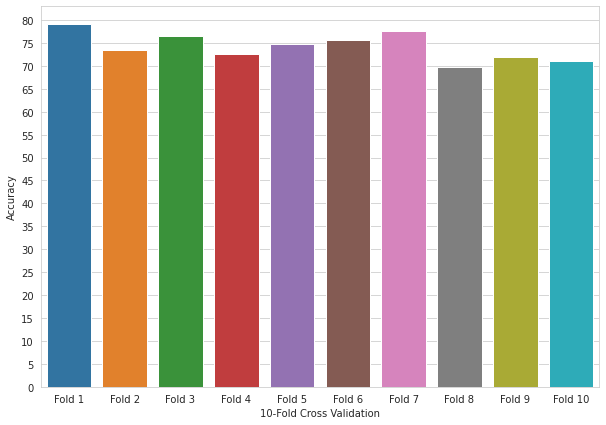

In [ ]:
def reset_weights(m):
  '''
    Try resetting model weights to avoid
    weight leakage.
  '''
  for layer in m.children():
      if hasattr(layer, 'reset_parameters'):
         print(f'Reset trainable parameters of layer = {layer}')
         layer.reset_parameters()

start_time = time.time()

k_folds = 10
loss = CrossEntropyLoss()
results = {}
kfold = KFold(n_splits=k_folds, shuffle=True, random_state=0)

print('---------------------------')
for fold, (tr_fold, tst_fold) in enumerate(kfold.split(dataset)):
    print(f'FOLD {fold + 1}')
    print('---------------------------')

    train_subsampler = torch.utils.data.SubsetRandomSampler(tr_fold)
    test_subsampler = torch.utils.data.SubsetRandomSampler(tst_fold)

    train_loader = torch.utils.data.DataLoader(dataset, batch_size=16, sampler=train_subsampler)
    test_loader = torch.utils.data.DataLoader(dataset, batch_size=1, sampler=test_subsampler)

    model_fold = CNN_Classifier()
    model_fold.apply(reset_weights)
    model_fold.to(gpu)

    print('\nTrain Subsampler Size:', len(train_subsampler))
    print('Test Subsampler Size:', len(test_subsampler))

    optimizer = optim.Adam(model_fold.parameters(), lr=learning_rate, weight_decay=wd)
    for epoch in tqdm(range(1, epochs + 1)):

      # TRAINING
      train_epoch_loss = 0
      train_epoch_acc = 0
      model_fold.train()

      for X_train, y_train in train_loader:
          X_train, y_train = X_train.to(gpu), y_train.to(gpu)

          optimizer.zero_grad()
          y_train_pred = model_fold(X_train).squeeze()

          train_loss = loss(y_train_pred, y_train)
          train_acc = measure_acc(y_train_pred, y_train)

          train_loss.backward()
          optimizer.step()

          train_epoch_loss += train_loss.item()
          train_epoch_acc += train_acc.item()

      loss_stats['train'].append(train_epoch_loss / len(train_loader))
      accuracy_stats['train'].append(train_epoch_acc / len(train_loader))
      
      print(
          f'Epochs {epoch + 0:02}: | Train Loss: {train_epoch_loss / len(train_loader):.4f} '
          f'| Train Accuracy: {train_epoch_acc / len(train_loader):.2f}')
      
      # print('Model is Saving...')
      # torch.save(model_fold.state_dict(), f'/content/drive/MyDrive/Colab Notebooks/COMP6721/Model_Weights/K-FOLD/model-fold-{fold}.pth')
      # print('Model is Saved.')

      print('\nStarting testing')
      model_fold.eval()
      correct, total = 0, 0
      with torch.no_grad():
        for x, y in tqdm(test_loader):
            x, y = x.to(gpu), y.to(gpu)

            img_x = utils.make_grid(x)

            outputs = model_fold(x)
            _, predicted = torch.max(outputs.data, 1)
            total += y.size(0)
            correct += (predicted == y).sum().item()

      print('Accuracy for fold %d: %d %%' % (fold + 1, 100.0 * correct / total))
      print('---------------------------')

      results[fold] = 100.0 * (correct / total)

print(f'K-FOLD CROSS VALIDATION RESULTS FOR {k_folds} FOLDS')
print('---------------------------')

sum = 0.0
fold_vals = []

for key, value in results.items():
    print(f'Fold {key + 1}: {(value):.2f} %')
    fold_vals.append(value)
    sum += value

print(f'Average: {sum/len(results.items()):.2f} %')
print(f'Total Training Time: {(time.time() - start_time)/60:.2f} min\n')
plt_folds(10, fold_vals, (10,7), np.arange(0, 100, 5), "Accuracy")